## Analysis of CRISPR screen data (Figures 2 and S2)

Import sample names and barcodes

In [1]:
#collect data locations
import os

summary_file = open('merged_fastq/file_key.csv')
sample_names = []
indices = []
for line in summary_file.readlines()[1:]:
    exp_name, flow_cell, lane, index, sample_name, file_name = line.strip().split(',')
    sample_names.append(sample_name)
    indices.append(index)
summary_file.close()

file_names = ['%s.fastq.gz' % (index) for index in indices]
data_folder = 'merged_fastq/'

file_paths = [os.path.join(data_folder, file_name) for file_name in file_names]
print(sample_names)
print(file_paths)

['cBZ056_UGAC_rep_1_input', 'cBZ056_UGAC_rep_1_low', 'cBZ056_UGAC_rep_2_input', 'cBZ056_UGAC_rep_2_low', 'cBZ058_AQP4_rep_1_input', 'cBZ058_AQP4_rep_1_low', 'cBZ058_AQP4_rep_2_input', 'cBZ058_AQP4_rep_2_low']
['merged_fastq/CAAGTT.fastq.gz', 'merged_fastq/TGGACC.fastq.gz', 'merged_fastq/ACTTGA.fastq.gz', 'merged_fastq/CTACTG.fastq.gz', 'merged_fastq/GGCAAC.fastq.gz', 'merged_fastq/TAGGCT.fastq.gz', 'merged_fastq/ATTCGG.fastq.gz', 'merged_fastq/GCCTAA.fastq.gz']


In [2]:
#define_some_helper_variables
cell_lines = ['cBZ056_UGAC', 'cBZ058_AQP4']
populations = ['input', 'low']
replicates = ['rep_1', 'rep_2']

Count guide spacers using code modified from Zhang lab github
This will launch a seperate simultaneous external process for each library, give them time to run.

In [3]:
import subprocess

counts_folder = 'counted_spacers/'
sgid_counts_folder = 'counted_spacers_by_sgid/'
try:
    os.mkdir(counts_folder)
except:
    pass
count_paths = [os.path.join(counts_folder, sample_name) for sample_name in sample_names]
sg_id_count_paths = [os.path.join(sgid_counts_folder, sample_name) for sample_name in sample_names]

for i in range(len(sample_names)):
    command = 'python annotation_files/count_spacers.py -f %s -o %s.txt -i annotation_files/brunello_spacers.txt 1>%s.log 2>%s.err' % (os.path.abspath(file_paths[i]), count_paths[i], count_paths[i], count_paths[i])
    print(command)
    #remove the .wait() to launch these simultaneously
    subprocess.Popen(command, shell=True).wait()

python annotation_files/count_spacers.py -f /fastscratch/boris/gigy_paper_compiled_analysis/F2_S2_CRISPR_screen/merged_fastq/CAAGTT.fastq.gz -o counted_spacers/cBZ056_UGAC_rep_1_input.txt -i annotation_files/brunello_spacers.txt 1>counted_spacers/cBZ056_UGAC_rep_1_input.log 2>counted_spacers/cBZ056_UGAC_rep_1_input.err
python annotation_files/count_spacers.py -f /fastscratch/boris/gigy_paper_compiled_analysis/F2_S2_CRISPR_screen/merged_fastq/TGGACC.fastq.gz -o counted_spacers/cBZ056_UGAC_rep_1_low.txt -i annotation_files/brunello_spacers.txt 1>counted_spacers/cBZ056_UGAC_rep_1_low.log 2>counted_spacers/cBZ056_UGAC_rep_1_low.err
python annotation_files/count_spacers.py -f /fastscratch/boris/gigy_paper_compiled_analysis/F2_S2_CRISPR_screen/merged_fastq/ACTTGA.fastq.gz -o counted_spacers/cBZ056_UGAC_rep_2_input.txt -i annotation_files/brunello_spacers.txt 1>counted_spacers/cBZ056_UGAC_rep_2_input.log 2>counted_spacers/cBZ056_UGAC_rep_2_input.err
python annotation_files/count_spacers.py -f

In [4]:
def get_guide_info(brunello_anno_file):
    guide_info = {}
    f = open(brunello_anno_file, 'rU')
    well_id = 1
    for line in f.readlines()[1:]:
        ll = line.rstrip('\n').split('\t')
        try:
            gene_index, gene_symbol, tx_target, gene_target, position_after_cut, strand, target_seq, target_context, PAM, exon_number, rule_set_2_score = ll
        except:
            print ll
        guide_info[target_seq] = (well_id, gene_symbol, position_after_cut)
        well_id += 1
    f.close()
    return guide_info

guide_info = get_guide_info('annotation_files/broadgpp-brunello-library-contents.txt')

In [5]:
#write counts for each sample to new file, indexed by sgid instead of sequence
os.mkdir('counted_spacers_by_sgid')
for file_index in range(len(count_paths)):
    in_file = open(count_paths[file_index]+'.txt')
    out_file = open(sg_id_count_paths[file_index]+'.txt', 'w')
    for line in in_file:
        guide, count = line.strip().split('\t')
        well_id, gene_symbol, position_after_cut = guide_info[guide]
        out_file.write('%d_%s_%s\t%s\n' % (well_id, gene_symbol, position_after_cut, count))
    in_file.close()
    out_file.close()

In [6]:
def counts_to_dict(file_name):
    count_dict = {}
    f = open(file_name)
    for line in f:
        guide, count = line.strip().split('\t')
        count_dict[guide] = int(count)
    f.close()
    return count_dict

def write_counts(counts, names, brunello_gpp_annotations, outfile, cutoff=0):
    f = open(outfile, 'w')
    header_entries = ['sgRNA', 'gene'] + [name for name in names]
    f.write('\t'.join(header_entries)+'\n')
    for guide in sorted(brunello_gpp_annotations.keys()):
        include = False
        for i in range(2):
            if counts[i][guide] >= cutoff:
                include = True
                break
        if include:
            entries = ['%d_%s_%s' % brunello_gpp_annotations[guide] , brunello_gpp_annotations[guide][1]] + ['%d' % counts[i][guide] for i in range(len(counts))]
            f.write('\t'.join(entries)+'\n')
    f.close()
    
counts = [counts_to_dict(count_path+'.txt') for count_path in count_paths]
write_counts(counts, sample_names, guide_info, 'combined_counts.tsv', cutoff=0)

In [7]:
#import counts as a dataframe
import pandas as pd

counts_dataframe = pd.read_csv('combined_counts.tsv', sep ='\t')

In [8]:
#colors - colorblind safe
black = (0,0,0)
gray = (0.6,0.6,0.6)
orange = (230/255.0,159/255.0,0)
skyBlue = (86/255.0,180/255.0,233/255.0)
bluishGreen = (0,158/255.0,115/255.0)
yellow = (240/255.0,228/255.0,66/255.0)
blue = (0,114/255.0,178/255.0)
vermillion = (213/255.0,94/255.0,0)
reddishPurple = (204/255.0,121/255.0,167/255.0)
colors = [black, orange, skyBlue, bluishGreen, vermillion, blue, reddishPurple, yellow]

plot some quality control plots
first plot replicates

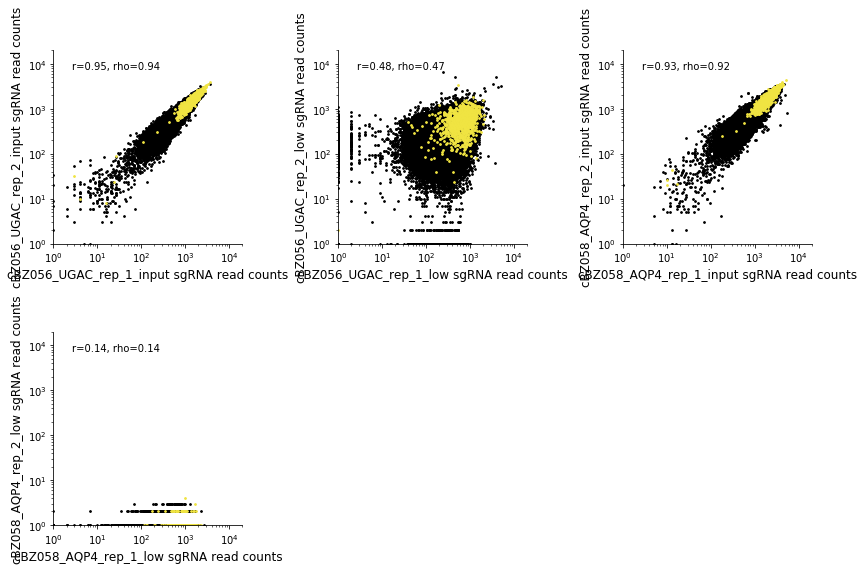

In [9]:
%matplotlib inline
import matplotlib.pyplot as plt
import scipy.stats as stats
plots=[]

num_plots_wide = 3
num_plots_high = 2
fig = plt.figure(figsize=(4*num_plots_wide, 4*num_plots_high))
#fig.subplots_adjust(wspace=0.4, hspace=0.4)
plot_index =1
for cell_line in cell_lines:
    for population in populations:
        rep1 = cell_line+'_'+replicates[0]+'_' + population
        rep2 = cell_line+'_'+replicates[1]+'_' + population
        plot = fig.add_subplot(num_plots_high, num_plots_wide, plot_index)

        #counts_dataframe.plot.scatter(x=rep1, y=rep2, ax=plot, s=3, color=black)
        counts_dataframe[counts_dataframe['gene']!='Non-Targeting Control'].plot.scatter(x=rep1, y=rep2, ax=plot, s=3, color=black)
        counts_dataframe[counts_dataframe['gene']=='Non-Targeting Control'].plot.scatter(x=rep1, y=rep2, ax=plot, s=3, color=yellow)
        spearmanR, spearmanP = stats.spearmanr(counts_dataframe[rep1], counts_dataframe[rep2])
        pearsonR, pearsonP = stats.pearsonr(counts_dataframe[rep1], counts_dataframe[rep2])
        plot.annotate("r=%.2f, rho=%.2f" %(pearsonR, spearmanR),xy=(.1, .9), xycoords=plot.transAxes)

        plot.set_xlabel("%s sgRNA read counts" % (rep1), fontsize = 12)
        plot.set_ylabel("%s sgRNA read counts" % (rep2), fontsize = 12)
        plot.set_yscale('log')
        plot.set_xscale('log')
        plot.set_xlim(1,20000)
        plot.set_ylim(1,20000)
        plot.spines['right'].set_visible(False)
        plot.spines['top'].set_visible(False)

        plot_index+=1
        plots.append(plot)
plt.tight_layout()
plt.savefig('replicate_correlations.pdf', transparent='True')
plt.savefig('replicate_correlations.png', transparent='True', dpi=800)

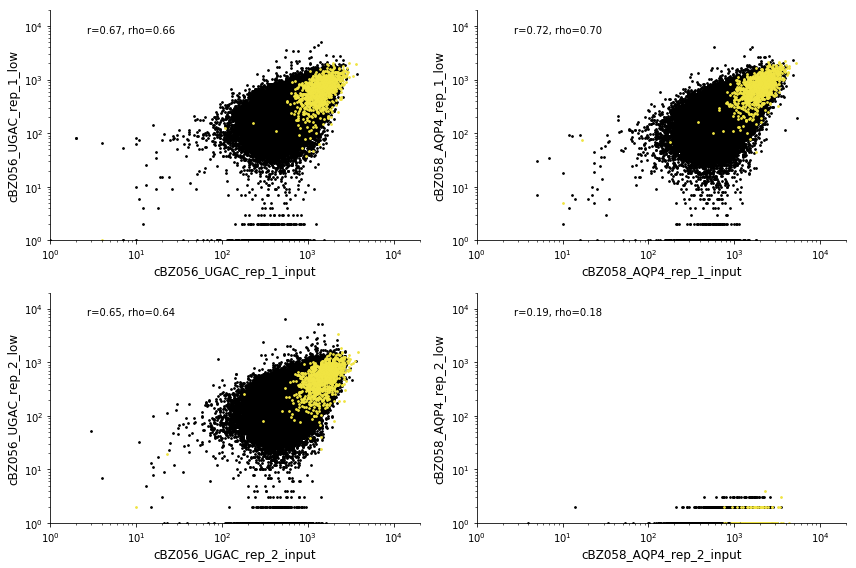

In [10]:
#plot some quality control plots
%matplotlib inline
import matplotlib.pyplot as plt
import scipy.stats as stats
plots=[]


fig = plt.figure(figsize=(4*num_plots_wide, 4*num_plots_high))
#fig.subplots_adjust(wspace=0.4, hspace=0.4)
plot_index =1
cond_pairs = [(0, 1)] #indices of conditions to pair
num_plots_wide = len(cond_pairs)* len(cell_lines)
num_plots_high = len(replicates)
for replicate in replicates:
    for cell_line in cell_lines:
        for cond_pair in cond_pairs:
            cond1 = cell_line+'_'+replicate+'_' + populations[cond_pair[0]]
            cond2 = cell_line+'_'+replicate+'_' + populations[cond_pair[1]]
            plot = fig.add_subplot(num_plots_high, num_plots_wide, plot_index)
            counts_dataframe[counts_dataframe['gene']!='Non-Targeting Control'].plot.scatter(x=cond1, y=cond2, ax=plot, s=3, color=black)
            counts_dataframe[counts_dataframe['gene']=='Non-Targeting Control'].plot.scatter(x=cond1, y=cond2, ax=plot, s=3, color=yellow)

            spearmanR, spearmanP = stats.spearmanr(counts_dataframe[cond1], counts_dataframe[cond2])
            pearsonR, pearsonP = stats.pearsonr(counts_dataframe[cond1], counts_dataframe[cond2])
            plot.annotate("r=%.2f, rho=%.2f" %(pearsonR, spearmanR),xy=(.1, .9), xycoords=plot.transAxes)
            plot.set_xlabel("%s" % (cond1), fontsize = 12)
            plot.set_ylabel("%s" % (cond2), fontsize = 12)
            plot.set_yscale('log')
            plot.set_xscale('log')
            plot.set_xlim(1,20000)
            plot.set_ylim(1,20000)
            plot.spines['right'].set_visible(False)
            plot.spines['top'].set_visible(False)
            plot_index+=1
            plots.append(plot)
plt.tight_layout()
plt.savefig('treated_untreated_scatter.pdf', transparent='True')
plt.savefig('treated_untreated_scatter.png', transparent='True', dpi=800)

### Run Mageck

In [11]:
if not os.path.exists('mageck_56_UGAC_low'):
    os.mkdir('mageck_56_UGAC_low')
if not os.path.exists('mageck_58_AQP4_low'):
    os.mkdir('mageck_58_AQP4_low')
!mageck test -k combined_counts.tsv -t cBZ056_UGAC_rep_1_low,cBZ056_UGAC_rep_2_low -c cBZ056_UGAC_rep_1_input,cBZ056_UGAC_rep_2_input -n mageck_56_UGAC_low/56_UGAC_low --remove-zero any --remove-zero-threshold 50
!mageck test -k combined_counts.tsv -t cBZ058_AQP4_rep_1_low -c cBZ058_AQP4_rep_1_input,cBZ058_AQP4_rep_2_input -n mageck_58_AQP4_low/58_AQP4_low --remove-zero any --remove-zero-threshold 50

INFO  @ Tue, 10 Nov 2020 02:24:34: Parameters: /home/boris/.local/bin/mageck test -k combined_counts.tsv -t cBZ056_UGAC_rep_1_low,cBZ056_UGAC_rep_2_low -c cBZ056_UGAC_rep_1_input,cBZ056_UGAC_rep_2_input -n mageck_56_UGAC_low/56_UGAC_low --remove-zero any --remove-zero-threshold 50 
INFO  @ Tue, 10 Nov 2020 02:24:34: Welcome to MAGeCK v0.5.7. Command: test 
INFO  @ Tue, 10 Nov 2020 02:24:34: Loading count table from combined_counts.tsv  
INFO  @ Tue, 10 Nov 2020 02:24:34: Processing 1 lines.. 
INFO  @ Tue, 10 Nov 2020 02:24:34: Loaded 77441 records. 
INFO  @ Tue, 10 Nov 2020 02:24:34: Loading R template file: /home/boris/.local/lib/python2.7/site-packages/mageck/plot_template.RTemplate. 
INFO  @ Tue, 10 Nov 2020 02:24:34: Loading R template file: /home/boris/.local/lib/python2.7/site-packages/mageck/plot_template_indvgene.RTemplate. 
INFO  @ Tue, 10 Nov 2020 02:24:34: Loading Rnw template file: /home/boris/.local/lib/python2.7/site-packages/mageck/plot_template.Rnw. 
INFO  @ Tue, 10 Nov

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 1081, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 2539, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 4094, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 5584, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 7228, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 8743, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 10271, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 11706, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 13162, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 14582, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 15967, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:44:   pid: 17465, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 18946, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 20349, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 21665, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 23019, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 24405, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 25703, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 27016, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 28251, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 29532, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 30823, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:45:   pid: 32208, prob:0.000000e+0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



@ Tue, 10 Nov 2020 02:24:47:   pid: 57301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57312, prob:0.000000e+00, sco

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 57990, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 58644, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59193, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 59741, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60259, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 60918, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 61521, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:47:   pid: 62045, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 62536, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63042, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 63676, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64263, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 64767, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65193, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 65648, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66219, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 66783, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67264, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 67664, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68120, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 68686, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69238, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 69695, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70122, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:48:   pid: 70534, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71073, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 71600, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72024, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72411, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 72819, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73358, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 73862, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74270, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74632, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 74999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75008, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75524, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 75999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76004, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76404, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 76767, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77152, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 77643, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:49:   pid: 78124, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78509, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 78843, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79207, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 79706, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80154, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80516, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 80854, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81192, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 81686, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82140, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82504, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 82819, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83157, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 83624, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84080, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84421, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:50:   pid: 84739, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85077, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85528, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 85962, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86304, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86622, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 86940, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87388, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 87822, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88140, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88435, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 88754, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89203, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89614, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 89929, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90201, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:51:   pid: 90496, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 90923, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91311, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91626, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 91897, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92192, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92627, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 92999, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93316, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93584, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 93854, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94264, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94649, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 94940, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95211, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95479, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 95889, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:52:   pid: 96274, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96565, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 96811, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97079, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97489, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 97850, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98142, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98387, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 98656, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99065, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99398, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99646, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 99896, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100145, prob

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100551, prob

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 100907, prob

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101178, prob

INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:53:   pid: 101402, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 101650, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102056, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102395, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102637, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 102862, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103110, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103493, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 103832, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104072, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104297, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104522, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 104908, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105248, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105495, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105696, prob

INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:54:   pid: 105920, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106280, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106621, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 106868, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107069, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107293, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107655, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 107972, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108219, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108422, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108647, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 108999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109010, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109326, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109550, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109750, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 109949, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110310, prob

INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:55:   pid: 110628, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 110852, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111053, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111254, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111615, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 111931, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112157, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112335, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112534, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 112872, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113188, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113387, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113571, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 113773, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114111, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114406, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114609, prob

INFO  @ Tue, 10 Nov 2020 02:24:56:   pid: 114778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114789, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 114989, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115327, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115620, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115823, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 115984, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116185, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116522, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 116817, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117019, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117203, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117380, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117694, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 117987, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118188, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118365, prob

INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:57:   pid: 118542, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 118882, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119177, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119379, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119540, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 119717, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120058, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120353, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120530, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120691, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 120867, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121185, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121457, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121658, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121819, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 121997, prob

INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:58:   pid: 122315, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122585, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122763, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 122901, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123056, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123372, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123644, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123822, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 123983, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124139, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124432, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124702, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 124879, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125040, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125194, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125486, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125756, prob

INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:24:59:   pid: 125940, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126097, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126251, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126546, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126818, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 126999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127002, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127134, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127288, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127604, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 127876, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128054, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128192, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128346, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128664, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 128913, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129097, prob

INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:00:   pid: 129229, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129383, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129676, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 129925, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130086, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130216, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130369, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130661, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 130906, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131059, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131197, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131351, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131642, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 131889, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132042, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132180, prob

INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:01:   pid: 132336, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132627, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 132872, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133029, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133167, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133321, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133614, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 133859, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134020, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134151, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134289, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134582, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134829, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 134982, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135090, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135228, prob

INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:02:   pid: 135496, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135741, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135895, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 135999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136010, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136140, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136408, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136655, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136816, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 136923, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137061, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137352, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137598, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137751, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137866, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 137999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138000, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138268, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138492, prob

INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:03:   pid: 138653, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138763, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 138901, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139169, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139414, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139567, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139675, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 139813, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140104, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140326, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140482, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140590, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140728, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 140996, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141218, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141373, prob

INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:04:   pid: 141488, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141618, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 141888, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142110, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142248, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142355, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142470, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142738, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 142960, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143117, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143232, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143365, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143633, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143857, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 143995, prob

INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:05:   pid: 144220, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144491, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144714, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 144844, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145044, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145313, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145535, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145673, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 145872, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146143, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146365, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146497, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146699, prob

INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:06:   pid: 146967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 146968, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147192, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147330, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147532, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147780, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 147999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148002, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148132, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148334, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148580, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148802, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 148940, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149142, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149390, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149614, prob

INFO  @ Tue, 10 Nov 2020 02:25:07:   pid: 149733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149744, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 149944, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150190, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150389, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150527, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150727, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 150998, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151197, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151327, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151529, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151775, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 151974, prob

INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:08:   pid: 152112, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152312, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152560, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152759, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 152874, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153054, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153300, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153499, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153614, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 153771, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154017, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154216, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154354, prob

INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:09:   pid: 154530, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154776, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 154977, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155084, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155245, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155491, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155690, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155805, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 155962, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156208, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156411, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156526, prob

INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:10:   pid: 156679, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 156927, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157128, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157243, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157396, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157642, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157841, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 157956, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158109, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158357, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158556, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158671, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 158824, prob

INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:11:   pid: 159049, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159248, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159363, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159518, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159763, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 159964, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160079, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160233, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160458, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160657, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160772, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 160928, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161176, prob

INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:12:   pid: 161377, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161492, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161648, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 161873, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162072, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162187, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162343, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162568, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162770, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 162885, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163038, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163261, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163439, prob

INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:13:   pid: 163577, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 163887, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164071, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164227, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164537, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164721, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164831, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 164985, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165207, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165391, prob

INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:14:   pid: 165547, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 165857, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166041, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166197, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166443, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166576, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166691, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 166800, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167025, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167209, prob

INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:15:   pid: 167339, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167631, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167807, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 167937, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168229, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168405, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168543, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 168827, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169011, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169144, prob

INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:16:   pid: 169436, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169616, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 169754, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170040, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170224, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170354, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170646, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170822, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 170952, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171244, prob

INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:17:   pid: 171428, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171559, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 171851, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172027, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172157, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172426, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172602, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 172740, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173027, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173211, prob

INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:18:   pid: 173344, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173636, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173815, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 173946, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174237, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174413, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174551, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 174837, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175021, prob

INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:19:   pid: 175154, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175423, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175602, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 175735, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176027, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176184, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176322, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176584, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176768, prob

INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:20:   pid: 176899, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177168, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177344, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177482, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177749, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 177910, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178018, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178312, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178465, prob

INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:21:   pid: 178603, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 178864, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179048, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179179, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179448, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179601, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179739, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 179999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180004, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180165, prob

INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:22:   pid: 180273, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180544, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180697, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 180812, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181083, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181240, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181378, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181623, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181776, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 181891, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182154, prob

INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:23:   pid: 182315, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182423, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182671, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182827, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 182942, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183213, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183369, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183484, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183745, prob

INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:24:   pid: 183906, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184013, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184261, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184422, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184531, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184777, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 184930, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185045, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185309, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185470, prob

INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:25:   pid: 185578, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185826, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 185982, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186097, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186345, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186500, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186615, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 186863, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187020, prob

INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:26:   pid: 187135, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187380, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187533, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187648, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 187895, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188048, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188163, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188408, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188565, prob

INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:27:   pid: 188680, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 188925, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189078, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189193, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189438, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189591, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189706, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 189930, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190083, prob

INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:28:   pid: 190198, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190422, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190575, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190690, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 190935, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191088, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191203, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191450, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191603, prob

INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:29:   pid: 191718, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 191942, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192095, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192210, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192432, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192585, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192700, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 192945, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193098, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193213, prob

INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:30:   pid: 193435, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193588, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193703, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 193948, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194101, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194216, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194438, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194592, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194700, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 194923, prob

INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:31:   pid: 195084, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195191, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195437, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195592, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195707, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 195955, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196085, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196200, prob

INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:32:   pid: 196445, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196577, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196692, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 196917, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197055, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197189, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197366, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197527, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197636, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197859, prob

INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:33:   pid: 197997, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198129, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198329, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198459, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198574, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198797, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 198927, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199042, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199267, prob

INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:34:   pid: 199397, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199512, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199737, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199870, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 199999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200008, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200184, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200317, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200455, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200634, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200767, prob

INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:35:   pid: 200905, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201084, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201217, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201355, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201534, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201667, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201782, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 201999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202007, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202137, prob

INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:36:   pid: 202275, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202454, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202584, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202722, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 202899, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203032, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203170, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203349, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203487, prob

INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:37:   pid: 203619, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203796, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 203934, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204066, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204243, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204381, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204511, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204688, prob

INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:38:   pid: 204826, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 204956, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205133, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205271, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205401, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205578, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205716, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 205938, prob

INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:39:   pid: 206069, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206292, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206422, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206560, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206739, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206877, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 206999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207009, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207186, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207324, prob

INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:40:   pid: 207456, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207633, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207771, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 207904, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208081, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208219, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208349, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208526, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208664, prob

INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:41:   pid: 208796, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 208973, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209111, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209241, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209418, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209556, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209686, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209863, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 209999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210001, prob

INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:42:   pid: 210134, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210311, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210449, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210583, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210760, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 210898, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211031, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211208, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211346, prob

INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:43:   pid: 211479, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211656, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211794, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 211926, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212103, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212241, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212374, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212551, prob

INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:44:   pid: 212689, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212821, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 212998, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213136, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213266, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213443, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213581, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213711, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 213888, prob

INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:45:   pid: 214026, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214158, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214335, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214450, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214580, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214734, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214849, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 214980, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215134, prob

INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:46:   pid: 215249, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215380, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215534, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215649, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215780, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 215934, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216049, prob

INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:47:   pid: 216180, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216357, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216472, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216605, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216759, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216874, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 216999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217005, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217182, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217297, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217430, prob

INFO  @ Tue, 10 Nov 2020 02:25:48:   pid: 217573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217584, prob

INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217699, prob

INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217830, prob

INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 217984, prob

INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218122, prob

INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218391, prob

INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:49:   pid: 218501, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218632, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218793, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 218901, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219032, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219193, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219301, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219432, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219593, prob

INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:50:   pid: 219701, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219832, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 219993, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220101, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220232, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220393, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220501, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220632, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220793, prob

INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:51:   pid: 220901, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221032, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221193, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221301, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221432, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221593, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221701, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221809, prob

INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:52:   pid: 221970, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222078, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222216, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222372, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222487, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222619, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222773, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222888, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 222995, prob

INFO  @ Tue, 10 Nov 2020 02:25:53:   pid: 223138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223149, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223264, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223372, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223533, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223641, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223749, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 223910, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224018, prob

INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:54:   pid: 224133, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224289, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224404, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224513, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224667, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224782, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 224892, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225069, prob

INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:55:   pid: 225184, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225338, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225453, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225563, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225717, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225832, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 225942, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226103, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226211, prob

INFO  @ Tue, 10 Nov 2020 02:25:56:   pid: 226308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226319, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226480, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226588, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226703, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226856, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 226971, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227081, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227235, prob

INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:57:   pid: 227350, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227460, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227614, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227729, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227837, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 227998, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228106, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228214, prob

INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:58:   pid: 228375, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228483, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228598, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228754, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228864, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 228979, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229133, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229248, prob

INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:25:59:   pid: 229358, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229512, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229627, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229737, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229898, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 229999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230006, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230114, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230275, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230383, prob

INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:00:   pid: 230498, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230654, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230764, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 230999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231010, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231125, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231235, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231389, prob

INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:01:   pid: 231504, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231750, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231858, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 231973, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232129, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232244, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232353, prob

INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:02:   pid: 232507, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232622, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232732, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232893, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 232999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233001, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233109, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233270, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233378, prob

INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:03:   pid: 233493, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233646, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233761, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 233871, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234025, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234140, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234385, prob

INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:04:   pid: 234493, prob

INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234738, prob

INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 234853, prob

INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235078, prob

INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235186, prob

INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235409, prob

INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:05:   pid: 235519, prob

INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235765, prob

INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 235880, prob

INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236105, prob

INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236213, prob

INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236435, prob

INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:06:   pid: 236573, prob

INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236775, prob

INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 236883, prob

INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237108, prob

INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237223, prob

INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:07:   pid: 237448, prob

INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237556, prob

INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237779, prob

INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 237909, prob

INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238093, prob

INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:08:   pid: 238224, prob

INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238401, prob

INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238539, prob

INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238717, prob

INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 238848, prob

INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239027, prob

INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:09:   pid: 239165, prob

INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239344, prob

INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239459, prob

INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239674, prob

INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239812, prob

INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:10:   pid: 239989, prob

INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240122, prob

INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240299, prob

INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240437, prob

INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240637, prob

INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240767, prob

INFO  @ Tue, 10 Nov 2020 02:26:11:   pid: 240933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 240944, prob

INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241082, prob

INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241282, prob

INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241415, prob

INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241615, prob

INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:12:   pid: 241753, prob

INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 241955, prob

INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242086, prob

INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242285, prob

INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242423, prob

INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:13:   pid: 242602, prob

INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242733, prob

INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 242912, prob

INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243050, prob

INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243229, prob

INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243362, prob

INFO  @ Tue, 10 Nov 2020 02:26:14:   pid: 243528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243539, prob

INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243677, prob

INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243854, prob

INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 243987, prob

INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244164, prob

INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:15:   pid: 244302, prob

INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244479, prob

INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244617, prob

INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244795, prob

INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 244926, prob

INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245105, prob

INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:16:   pid: 245243, prob

INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245419, prob

INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245552, prob

INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245729, prob

INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 245867, prob

INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:17:   pid: 246044, prob

INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246174, prob

INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246358, prob

INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246489, prob

INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246666, prob

INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246799, prob

INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:18:   pid: 246983, prob

INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247114, prob

INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247291, prob

INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247424, prob

INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247608, prob

INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:19:   pid: 247739, prob

INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 247916, prob

INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248054, prob

INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248230, prob

INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248361, prob

INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248537, prob

INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:20:   pid: 248675, prob

INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248854, prob

INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 248987, prob

INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249148, prob

INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:21:   pid: 249279, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249456, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249589, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249773, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 249904, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250081, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250214, prob

INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:22:   pid: 250398, prob

INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250529, prob

INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250729, prob

INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250844, prob

INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 250951, prob

INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251105, prob

INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:23:   pid: 251243, prob

INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251465, prob

INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251596, prob

INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251775, prob

INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 251913, prob

INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:24:   pid: 252092, prob

INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252223, prob

INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252402, prob

INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252540, prob

INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252719, prob

INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 252852, prob

INFO  @ Tue, 10 Nov 2020 02:26:25:   pid: 253018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253029, prob

INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253167, prob

INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253344, prob

INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253477, prob

INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253654, prob

INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:26:   pid: 253792, prob

INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 253969, prob

INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254099, prob

INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254283, prob

INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:27:   pid: 254414, prob

INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254591, prob

INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254724, prob

INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 254908, prob

INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255038, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255039, prob

INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255216, prob

INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:28:   pid: 255354, prob

INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255532, prob

INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255663, prob

INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255842, prob

INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 255980, prob

INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:29:   pid: 256159, prob

INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256292, prob

INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256469, prob

INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256607, prob

INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256784, prob

INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 256917, prob

INFO  @ Tue, 10 Nov 2020 02:26:30:   pid: 257083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257094, prob

INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257232, prob

INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257409, prob

INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257539, prob

INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257723, prob

INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:31:   pid: 257854, prob

INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258031, prob

INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258164, prob

INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258348, prob

INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258479, prob

INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258656, prob

INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:32:   pid: 258771, prob

INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 258901, prob

INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259124, prob

INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259257, prob

INFO  @ Tue, 10 Nov 2020 02:26:33:   pid: 259423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259434, prob

INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259572, prob

INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259749, prob

INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 259879, prob

INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260063, prob

INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:34:   pid: 260194, prob

INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260371, prob

INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260509, prob

INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260687, prob

INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:35:   pid: 260818, prob

INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 260997, prob

INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261135, prob

INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261314, prob

INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261444, prob

INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261628, prob

INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:36:   pid: 261759, prob

INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 261936, prob

INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:37:   pid: 262069, prob

INFO  @ Tue, 10 Nov 2020 02:26:42: Command message: 
INFO  @ Tue, 10 Nov 2020 02:26:42:   Welcome to RRA v 0.5.7. 
INFO  @ Tue, 10 Nov 2020 02:26:42:   Skipping gene NA for permutation ... 
INFO  @ Tue, 10 Nov 2020 02:26:42:   Skipping gene na for permutation ... 
INFO  @ Tue, 10 Nov 2020 02:26:42:   Reading input file... 
INFO  @ Tue, 10 Nov 2020 02:26:42:   Summary: 74701 sgRNAs, 19115 genes, 2 lists; skipped sgRNAs:203 
INFO  @ Tue, 10 Nov 2020 02:26:42:   Computing lo-values for each group... 
INFO  @ Tue, 10 Nov 2020 02:26:42:   probs:0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00

INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 8, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 9, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 10, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 11, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 12, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 13, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 14, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 15, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 16, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 17, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 18, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:42:   pid: 19, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 No

INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 240, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 378, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 569, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 708, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 870, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:43:   pid: 990, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1175, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1316, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1504, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1644, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:44:   pid: 1819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1830, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 1972, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2135, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2276, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:45:   pid: 2464, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2580, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2745, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 2861, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3026, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:46:   pid: 3166, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3353, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3471, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3658, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3776, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 3940, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:47:   pid: 4045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4056, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4245, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4361, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4526, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:48:   pid: 4666, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4853, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 4971, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5159, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5276, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5464, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:49:   pid: 5582, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5769, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 5886, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6039, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6050, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:50:   pid: 6167, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6354, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6471, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6635, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6753, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 6941, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:51:   pid: 7058, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7246, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7362, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7527, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7639, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7643, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:52:   pid: 7819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7830, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 7948, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8112, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8229, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8394, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:53:   pid: 8511, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8675, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8793, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 8957, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:54:   pid: 9075, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9239, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9356, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9520, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9636, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9801, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 9918, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:55:   pid: 10078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10081, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10183, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10336, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:56:   pid: 10452, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10608, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10724, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10881, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 10988, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11151, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:57:   pid: 11258, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11411, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11527, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11684, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11801, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:58:   pid: 11956, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12063, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12226, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12333, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12486, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:26:59:   pid: 12602, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12758, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 12874, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13029, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13136, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:00:   pid: 13278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13289, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13406, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13559, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13676, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13833, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:01:   pid: 13949, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14081, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14281, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14388, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:02:   pid: 14551, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14658, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14811, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 14927, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15083, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:03:   pid: 15199, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15354, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15461, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15614, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15731, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:04:   pid: 15884, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 15999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16001, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16156, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16263, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16426, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:05:   pid: 16533, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16686, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16802, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 16959, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:06:   pid: 17076, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17231, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17338, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17501, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17608, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:07:   pid: 17877, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18033, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18139, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18302, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18409, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:08:   pid: 18553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18564, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18681, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18834, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 18951, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19108, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19213, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:09:   pid: 19224, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19379, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19486, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19639, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:10:   pid: 19756, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 19909, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20026, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20181, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20288, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:11:   pid: 20451, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20558, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20711, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20827, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 20983, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:12:   pid: 21099, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21254, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21361, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21514, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:13:   pid: 21631, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21784, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 21901, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22056, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22163, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22326, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:14:   pid: 22433, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22586, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22702, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22858, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 22974, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:15:   pid: 23129, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23236, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23389, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23506, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23659, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:16:   pid: 23776, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 23929, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24036, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24189, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:17:   pid: 24306, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24459, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24576, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24731, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24838, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 24999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 25000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:18:   pid: 25001, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25108, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25261, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25377, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25534, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:19:   pid: 25651, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25806, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 25913, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26076, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:20:   pid: 26183, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26336, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26452, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26609, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26726, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:21:   pid: 26881, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 26988, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27151, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27258, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27411, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:22:   pid: 27527, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27683, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27799, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 27956, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28063, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:23:   pid: 28226, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28333, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28486, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28602, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28758, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:24:   pid: 28874, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29029, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29136, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29289, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:25:   pid: 29406, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29559, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29676, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29833, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 29949, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:26:   pid: 30104, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30211, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30364, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30481, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30634, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:27:   pid: 30751, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 30906, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31013, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31176, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:28:   pid: 31283, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31436, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31552, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31709, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31826, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:29:   pid: 31981, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32088, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32251, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32358, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32511, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:30:   pid: 32627, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32783, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 32899, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33054, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:31:   pid: 33303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33314, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33431, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33584, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33701, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33858, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:32:   pid: 33974, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34083, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34259, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:33:   pid: 34376, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34531, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34638, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34801, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 34908, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35061, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:34:   pid: 35177, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35333, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35449, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35604, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35711, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:35:   pid: 35853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35864, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 35981, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36134, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36251, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:36:   pid: 36404, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36511, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36663, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36664, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36781, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 36934, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:37:   pid: 37051, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37208, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37324, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:38:   pid: 37456, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37563, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37702, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37809, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 37964, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:39:   pid: 38081, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38234, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38351, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38506, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38613, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:40:   pid: 38776, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 38883, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39036, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39152, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39309, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:41:   pid: 39426, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39581, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39688, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39851, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:42:   pid: 39958, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40111, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40227, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40383, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40499, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:43:   pid: 40654, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 40914, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41031, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:44:   pid: 41277, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41433, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41549, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41706, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41813, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:45:   pid: 41976, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42083, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42236, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:46:   pid: 42352, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42508, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42624, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42779, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 42886, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:47:   pid: 43026, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43133, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43286, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43402, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43513, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:48:   pid: 43629, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 43877, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44034, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:49:   pid: 44151, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44308, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44424, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44579, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44686, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:50:   pid: 44828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44839, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 44956, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45109, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45226, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45383, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:51:   pid: 45499, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45654, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 45914, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:52:   pid: 46031, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46184, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46301, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46456, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46563, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:53:   pid: 46726, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46833, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 46986, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47102, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47236, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:54:   pid: 47352, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47509, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47626, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47781, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 47888, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48040, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:55:   pid: 48051, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48158, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48311, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48427, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48583, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:56:   pid: 48699, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48854, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 48961, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49114, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:57:   pid: 49231, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49384, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49501, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49654, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:58:   pid: 49903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 49914, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50031, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50277, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50411, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:27:59:   pid: 50527, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50636, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50752, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 50908, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51024, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:00:   pid: 51179, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51286, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51426, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51533, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51686, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:01:   pid: 51802, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 51911, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52027, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:02:   pid: 52277, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52386, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52502, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52611, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:03:   pid: 52727, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52859, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 52976, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53131, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53238, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53354, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53461, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:04:   pid: 53577, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53684, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53801, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 53908, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:05:   pid: 54003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54014, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54131, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54284, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54401, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:06:   pid: 54556, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54663, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54779, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54886, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 54999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55002, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55109, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:07:   pid: 55226, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55333, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55439, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:08:   pid: 55556, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55661, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55662, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55663, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55779, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55888, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 55999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56004, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56113, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:09:   pid: 56229, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56338, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56454, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56563, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:10:   pid: 56679, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56811, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 56927, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57036, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57152, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57308, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:11:   pid: 57424, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57533, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57639, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57756, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:12:   pid: 57861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57863, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 57979, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58086, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58202, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58309, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:13:   pid: 58426, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58533, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58638, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58639, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58756, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58863, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:14:   pid: 58979, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59088, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59204, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59313, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:15:   pid: 59429, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59561, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59677, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59786, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:16:   pid: 59902, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60011, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60127, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60238, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60354, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60463, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:17:   pid: 60579, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60688, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60804, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 60936, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:18:   pid: 61052, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61159, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61276, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61384, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61501, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61609, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:19:   pid: 61726, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61834, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 61951, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62059, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:20:   pid: 62176, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62284, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62401, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62509, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:21:   pid: 62626, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62734, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62851, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 62958, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63064, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:22:   pid: 63181, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63288, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63404, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63511, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63627, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63734, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:23:   pid: 63851, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 63958, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64064, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:24:   pid: 64181, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64288, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64404, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64513, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64629, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64738, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:25:   pid: 64854, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 64963, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65079, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65188, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:26:   pid: 65304, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65413, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65529, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65638, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:27:   pid: 65754, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65863, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 65979, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66086, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66202, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66311, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:28:   pid: 66427, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66536, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66652, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:29:   pid: 66877, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 66986, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67102, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67209, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:30:   pid: 67326, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67434, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67551, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67659, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67776, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67886, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 67999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 68000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 68001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:31:   pid: 68002, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68111, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68227, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68336, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:32:   pid: 68452, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68559, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68676, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68786, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:33:   pid: 68902, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69011, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69127, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69236, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69352, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69459, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:34:   pid: 69576, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69684, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69792, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69801, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 69909, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:35:   pid: 70026, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70134, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70251, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70359, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:36:   pid: 70476, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70584, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70701, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70809, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:37:   pid: 70926, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71034, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71151, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71259, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71376, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71486, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:38:   pid: 71602, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71711, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71827, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 71936, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:39:   pid: 72052, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72277, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72386, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:40:   pid: 72502, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72611, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72727, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72836, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 72952, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73061, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:41:   pid: 73177, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73309, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73488, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:42:   pid: 73604, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73711, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73827, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 73936, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:43:   pid: 74052, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74277, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74386, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:44:   pid: 74502, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74611, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74727, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74836, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 74952, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75061, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:45:   pid: 75177, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75288, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75404, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75513, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:46:   pid: 75629, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75738, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75854, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 75963, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:47:   pid: 76079, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76188, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76304, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76411, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:48:   pid: 76527, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76634, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76751, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76859, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 76976, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77084, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:49:   pid: 77201, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77309, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77426, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77534, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:50:   pid: 77651, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77758, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77864, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 77981, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78088, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:51:   pid: 78204, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78311, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78427, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78534, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78640, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78641, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78642, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:52:   pid: 78651, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78758, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78864, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 78981, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79088, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:53:   pid: 79204, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79313, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79429, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79538, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:54:   pid: 79654, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79761, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79877, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 79984, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:55:   pid: 80101, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80209, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80326, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80434, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:56:   pid: 80551, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80659, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80776, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80883, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 80989, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:57:   pid: 81106, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81213, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81329, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81436, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81552, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81659, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:58:   pid: 81776, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81883, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 81989, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:28:59:   pid: 82106, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82209, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82210, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82211, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82212, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82213, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82329, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82438, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:00:   pid: 82554, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82659, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82660, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82661, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82777, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82886, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 82999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 83000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 83001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:01:   pid: 83002, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83111, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83227, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83336, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83452, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83561, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:02:   pid: 83677, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83786, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83901, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 83902, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84011, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:03:   pid: 84127, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84236, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84352, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84463, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:04:   pid: 84579, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84688, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84804, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 84913, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:05:   pid: 85029, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85138, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85254, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85363, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:06:   pid: 85479, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85586, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85702, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85811, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 85927, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86036, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:07:   pid: 86152, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86261, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86377, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86484, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:08:   pid: 86601, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86708, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86814, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 86931, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87038, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:09:   pid: 87154, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87261, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87377, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87484, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:10:   pid: 87601, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87708, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87814, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:11:   pid: 87931, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88038, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88154, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88263, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88379, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:12:   pid: 88488, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88604, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88713, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88829, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 88938, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:13:   pid: 89054, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89163, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89279, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89388, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:14:   pid: 89504, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89613, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89729, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89838, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:15:   pid: 89954, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90086, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90263, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:16:   pid: 90379, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90486, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90602, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90711, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:17:   pid: 90827, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 90936, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91052, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91161, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:18:   pid: 91277, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91386, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91502, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91609, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91726, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91834, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:19:   pid: 91951, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92059, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92176, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92284, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:20:   pid: 92401, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92509, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92626, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92734, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:21:   pid: 92851, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92957, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 92959, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93076, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93182, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93186, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:22:   pid: 93302, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93405, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93411, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93521, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93522, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93523, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93524, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93525, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93526, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93527, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93638, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:23:   pid: 93754, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93854, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93855, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93856, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93857, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93863, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 93979, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94079, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94080, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94088, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:24:   pid: 94204, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94302, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94303, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94304, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94305, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94313, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94429, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94527, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94528, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94529, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94530, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94538, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94654, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94754, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94755, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94756, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94757, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94763, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:25:   pid: 94879, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94978, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94979, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94980, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94981, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94982, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 94986, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95102, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95202, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95203, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95204, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95205, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95206, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95207, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95208, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95209, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:26:   pid: 95326, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95434, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95551, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95654, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95655, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95656, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95657, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95658, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95659, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:27:   pid: 95776, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95879, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95880, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95884, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 95999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96001, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96100, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96101, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96102, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96103, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96104, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96105, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96109, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:28:   pid: 96226, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96325, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96326, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96327, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96328, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96334, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96440, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96451, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96548, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96549, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96550, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96551, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96552, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96553, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96554, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96555, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96559, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:29:   pid: 96676, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96784, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96900, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 96901, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97002, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97003, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97011, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:30:   pid: 97127, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97236, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97352, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97454, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97455, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97463, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:31:   pid: 97579, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97677, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97678, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97679, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97680, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97688, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97793, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97794, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97795, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97796, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97797, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97798, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97799, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97800, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97801, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97804, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97902, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97903, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97904, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97905, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97906, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97907, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97908, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97909, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97910, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97911, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 97913, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98029, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98129, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98130, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98131, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98132, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98133, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98134, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98138, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:32:   pid: 98254, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98352, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98353, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98354, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98355, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98356, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98357, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98363, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98479, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98577, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98578, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98579, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98580, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98581, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98582, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98588, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:33:   pid: 98704, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98802, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98803, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98813, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98923, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98924, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 98929, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99025, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99026, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99036, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:34:   pid: 99152, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99254, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99255, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99261, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99377, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99486, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:35:   pid: 99602, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99700, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99701, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99702, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99703, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99704, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99705, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99706, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99707, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99708, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99711, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99827, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99925, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99926, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99927, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99928, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99929, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99930, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99931, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99932, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 99936, prob:0.000000e+0

INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:36:   pid: 100052, prob

INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100155, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100160, prob

INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100275, prob

INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100385, prob

INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:37:   pid: 100500, prob

INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100605, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100610, prob

INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100725, prob

INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100832, prob

INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:38:   pid: 100947, prob

INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101057, prob

INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101172, prob

INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101282, prob

INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:39:   pid: 101397, prob

INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101505, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101507, prob

INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101622, prob

INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101730, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101732, prob

INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:40:   pid: 101847, prob

INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101950, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101951, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101952, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101953, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101954, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101955, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101956, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 101957, prob

INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102072, prob

INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102179, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102180, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102181, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102182, prob

INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:41:   pid: 102297, prob

INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102402, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102403, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102404, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102405, prob

INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102520, prob

INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102628, prob

INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102743, prob

INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:42:   pid: 102876, prob

INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103055, prob

INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103170, prob

INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103277, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103278, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103280, prob

INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:43:   pid: 103395, prob

INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103502, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103503, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103504, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103505, prob

INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103620, prob

INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103727, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103728, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103729, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103730, prob

INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103842, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:44:   pid: 103845, prob

INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103977, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 103978, prob

INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104152, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104153, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104154, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104155, prob

INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:45:   pid: 104270, prob

INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104380, prob

INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104495, prob

INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104600, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104601, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104602, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104603, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104604, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104605, prob

INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104709, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104710, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104711, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104712, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104713, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:46:   pid: 104720, prob

INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104830, prob

INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 104945, prob

INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105055, prob

INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:47:   pid: 105170, prob

INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105277, prob

INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105390, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105392, prob

INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105500, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105501, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105502, prob

INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105606, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105607, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105608, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105609, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105610, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105611, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:48:   pid: 105617, prob

INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105727, prob

INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105842, prob

INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:49:   pid: 105975, prob

INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106146, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106147, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106148, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106149, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106150, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106151, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106152, prob

INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106256, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106257, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106258, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106259, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106260, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106261, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106262, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106263, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106267, prob

INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106375, prob

INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106479, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106480, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106481, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106482, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:50:   pid: 106490, prob

INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106612, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106613, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106623, prob

INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106777, prob

INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106881, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106882, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:51:   pid: 106892, prob

INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107025, prob

INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107175, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107176, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107177, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107178, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107179, prob

INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:52:   pid: 107294, prob

INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107391, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107392, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107393, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107394, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107395, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107396, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107397, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107398, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107399, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107400, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107401, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107402, prob

INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107506, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107507, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107508, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107509, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107517, prob

INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107625, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107626, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107627, prob

INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107731, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107732, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107733, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107734, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:53:   pid: 107742, prob

INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 107875, prob

INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108041, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108042, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108052, prob

INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:54:   pid: 108167, prob

INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108264, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108265, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108275, prob

INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108387, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108388, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108389, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108390, prob

INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108510, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108511, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108512, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108513, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108514, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108515, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108516, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108517, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108518, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108519, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108520, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108521, prob

INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108700, prob

INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108804, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108805, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108806, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108807, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108808, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108809, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108810, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108811, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108812, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108813, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:55:   pid: 108815, prob

INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 108923, prob

INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109038, prob

INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:56:   pid: 109171, prob

INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109325, prob

INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109438, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109439, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109440, prob

INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:57:   pid: 109571, prob

INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109727, prob

INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109842, prob

INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109946, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109947, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109948, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109949, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 109950, prob

INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110054, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110055, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110056, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110057, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110058, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110059, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110060, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110061, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110062, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110063, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:58:   pid: 110065, prob

INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110169, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110170, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110171, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110172, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110173, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110174, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110175, prob

INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110279, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110280, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110281, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110282, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110283, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110284, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110285, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110286, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110287, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110288, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110290, prob

INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:29:59:   pid: 110423, prob

INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110569, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110570, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110571, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110572, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110573, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110574, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110575, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110576, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110577, prob

INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110681, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110682, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110683, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110684, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110685, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110686, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110687, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110688, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110692, prob

INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110814, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110815, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110816, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110817, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:00:   pid: 110825, prob

INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110994, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110995, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110996, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110997, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110998, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 110999, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111000, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111001, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111002, prob

INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111106, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111107, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111108, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111109, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111110, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111111, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111117, prob

INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111227, prob

INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:01:   pid: 111342, prob

INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111452, prob

INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111567, prob

INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111675, prob

INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111779, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111780, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:02:   pid: 111790, prob

INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111912, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111913, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111914, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111915, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111916, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111917, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111918, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111919, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111920, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111921, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111922, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 111923, prob

INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112077, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112078, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112079, prob

INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112183, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112184, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112185, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112186, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112187, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112188, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112189, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112190, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:03:   pid: 112194, prob

INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112317, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112318, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112319, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112320, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112321, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112322, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112323, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112324, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112325, prob

INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112477, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112478, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112479, prob

INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112583, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112584, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112585, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112586, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112587, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112588, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:04:   pid: 112594, prob

INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112714, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112715, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112725, prob

INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112877, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112878, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112879, prob

INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112983, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112984, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112985, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112986, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112987, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112988, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112989, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112990, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112991, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112992, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112993, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:05:   pid: 112994, prob

INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113125, prob

INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113300, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113301, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113302, prob

INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113406, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113407, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113408, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113409, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113410, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113411, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113412, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113413, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113414, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113415, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:06:   pid: 113417, prob

INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113546, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113547, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113548, prob

INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113716, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113717, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113718, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113719, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113720, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113721, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113722, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113723, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113724, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113725, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113726, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113727, prob

INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113838, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113839, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113840, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113841, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:07:   pid: 113842, prob

INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 113975, prob

INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114123, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114124, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114125, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114126, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114127, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114128, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114129, prob

INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114238, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114239, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114240, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114241, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114242, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:08:   pid: 114244, prob

INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114346, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114347, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114348, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114349, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114350, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114351, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114352, prob

INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114456, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114457, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114458, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114459, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114460, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114461, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114462, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114463, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114464, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114465, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114467, prob

INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114589, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114590, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114591, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114592, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114593, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114594, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114595, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114596, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114597, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114598, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114599, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114600, prob

INFO  @ Tue, 10 Nov 2020 02:30:09:   pid: 114743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114746, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114747, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114748, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114749, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114750, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114751, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114752, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114753, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114754, prob

INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114858, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114859, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114860, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114861, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114862, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114863, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114864, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114865, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114869, prob

INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114969, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114970, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114971, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114972, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114973, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114974, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114975, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114976, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 114977, prob

INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115081, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115082, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115083, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115084, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115085, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115086, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115087, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115088, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115092, prob

INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115214, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115215, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115216, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115217, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115225, prob

INFO  @ Tue, 10 Nov 2020 02:30:10:   pid: 115368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115369, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115370, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115371, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115372, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115373, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115374, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115375, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115379, prob

INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115483, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115484, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115485, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115486, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115487, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115488, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115494, prob

INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115614, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115615, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115616, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115617, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115618, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115619, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115620, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115621, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115622, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115623, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115624, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115625, prob

INFO  @ Tue, 10 Nov 2020 02:30:11:   pid: 115768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115769, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115770, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115771, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115772, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115773, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115774, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115775, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115776, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115777, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115778, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115779, prob

INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115883, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115884, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115885, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115886, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115887, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115888, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 115894, prob

INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116015, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116016, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116017, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116018, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116019, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116020, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116021, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116022, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116023, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116024, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:12:   pid: 116025, prob

INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116191, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116192, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116193, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116194, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116195, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116196, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116197, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116198, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116199, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116200, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116201, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116202, prob

INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116306, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116307, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116308, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116309, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116310, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116311, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116312, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116313, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116314, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116315, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116316, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116317, prob

INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116416, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116417, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116418, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116419, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116420, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116421, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116422, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116423, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116424, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116425, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116426, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116427, prob

INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116531, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116532, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116533, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116534, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:13:   pid: 116542, prob

INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116664, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116675, prob

INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116818, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116819, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116820, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116821, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116822, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116823, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116824, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116825, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116826, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116829, prob

INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116933, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116934, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:14:   pid: 116944, prob

INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117064, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117065, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117075, prob

INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117218, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117219, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117220, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117221, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117222, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117223, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117224, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117225, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117226, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117229, prob

INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:15:   pid: 117344, prob

INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117441, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117442, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117452, prob

INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117556, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117557, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117567, prob

INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117700, prob

INFO  @ Tue, 10 Nov 2020 02:30:16:   pid: 117843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117854, prob

INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 117969, prob

INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118100, prob

INFO  @ Tue, 10 Nov 2020 02:30:17:   pid: 118243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118254, prob

INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118369, prob

INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118500, prob

INFO  @ Tue, 10 Nov 2020 02:30:18:   pid: 118643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118654, prob

INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118769, prob

INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 118900, prob

INFO  @ Tue, 10 Nov 2020 02:30:19:   pid: 119043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119054, prob

INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119169, prob

INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119300, prob

INFO  @ Tue, 10 Nov 2020 02:30:20:   pid: 119443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119454, prob

INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119569, prob

INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119700, prob

INFO  @ Tue, 10 Nov 2020 02:30:21:   pid: 119843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119854, prob

INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 119969, prob

INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120089, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120090, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120091, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120092, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120093, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120094, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120095, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120096, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120097, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120098, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120099, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120100, prob

INFO  @ Tue, 10 Nov 2020 02:30:22:   pid: 120243, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120244, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120245, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120246, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120247, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120248, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120249, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120250, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120251, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120252, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120253, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120254, prob

INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120358, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120359, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120360, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120361, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120362, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120363, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120364, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120365, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120366, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120367, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120368, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120369, prob

INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120489, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120490, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120491, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120492, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120493, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120494, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120495, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120496, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120497, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120498, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120499, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120500, prob

INFO  @ Tue, 10 Nov 2020 02:30:23:   pid: 120643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120654, prob

INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120758, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120759, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120760, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120761, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120762, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120763, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120764, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120765, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120766, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120767, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120768, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120769, prob

INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 120900, prob

INFO  @ Tue, 10 Nov 2020 02:30:24:   pid: 121043, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121044, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121045, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121046, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121047, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121048, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121049, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121050, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121051, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121052, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121053, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121054, prob

INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121167, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121168, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121169, prob

INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121289, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121290, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121291, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121292, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121293, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121294, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121295, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121296, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121297, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121298, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121299, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121300, prob

INFO  @ Tue, 10 Nov 2020 02:30:25:   pid: 121443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121454, prob

INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121569, prob

INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121689, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121690, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121691, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121692, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121693, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121694, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121695, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121696, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121697, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121698, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121699, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121700, prob

INFO  @ Tue, 10 Nov 2020 02:30:26:   pid: 121843, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121844, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121845, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121846, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121847, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121848, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121849, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121850, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121851, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121852, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121853, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121854, prob

INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121958, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121959, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121960, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121961, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121962, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121963, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121964, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121965, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121966, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121967, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121968, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 121969, prob

INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122077, prob

INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:27:   pid: 122238, prob

INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122346, prob

INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122477, prob

INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:28:   pid: 122638, prob

INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122746, prob

INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 122877, prob

INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:29:   pid: 123038, prob

INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123146, prob

INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123277, prob

INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:30:   pid: 123438, prob

INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123546, prob

INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123677, prob

INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123827, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123828, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123829, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123830, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123831, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123832, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123833, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123834, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123835, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123836, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123837, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:31:   pid: 123838, prob

INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123935, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123936, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123937, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123938, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123939, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123940, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123941, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123942, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123943, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123944, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123945, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 123946, prob

INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124066, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124067, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124068, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124069, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124070, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124071, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124072, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124073, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124074, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124075, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124076, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124077, prob

INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:32:   pid: 124238, prob

INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124346, prob

INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124466, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124467, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124468, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124469, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124470, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124471, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124472, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124473, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124474, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124475, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124476, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124477, prob

INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124627, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124628, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124629, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124630, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124631, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124632, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124633, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124634, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124635, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124636, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124637, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:33:   pid: 124638, prob

INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124735, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124736, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124737, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124738, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124739, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124740, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124741, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124742, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124743, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124744, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124745, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124746, prob

INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124866, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124867, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124868, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124869, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124870, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124871, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124872, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124873, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124874, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124875, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124876, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 124877, prob

INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125027, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125028, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125029, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125030, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125031, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125032, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125033, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125034, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125035, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125036, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125037, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:34:   pid: 125038, prob

INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125135, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125136, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125137, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125138, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125139, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125140, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125141, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125142, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125143, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125144, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125145, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125146, prob

INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125266, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125267, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125268, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125269, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125270, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125271, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125272, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125273, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125274, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125275, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125276, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125277, prob

INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125427, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125428, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125429, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125430, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125431, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125432, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125433, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125434, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125435, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125436, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125437, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:35:   pid: 125438, prob

INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125535, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125536, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125537, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125538, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125539, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125540, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125541, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125542, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125543, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125544, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125545, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125546, prob

INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125643, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125644, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125645, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125646, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125647, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125648, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125649, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125650, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125651, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125652, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125653, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125654, prob

INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:36:   pid: 125792, prob

INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 125900, prob

INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:37:   pid: 126015, prob

INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126123, prob

INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:38:   pid: 126238, prob

INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126346, prob

INFO  @ Tue, 10 Nov 2020 02:30:39:   pid: 126443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126454, prob

INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:40:   pid: 126569, prob

INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126677, prob

INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:41:   pid: 126792, prob

INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 126900, prob

INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:42:   pid: 127015, prob

INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127123, prob

INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:43:   pid: 127238, prob

INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127346, prob

INFO  @ Tue, 10 Nov 2020 02:30:44:   pid: 127443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127454, prob

INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:45:   pid: 127569, prob

INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127677, prob

INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:47:   pid: 127792, prob

INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 127900, prob

INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:48:   pid: 128015, prob

INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128123, prob

INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:49:   pid: 128238, prob

INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128346, prob

INFO  @ Tue, 10 Nov 2020 02:30:50:   pid: 128443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128454, prob

INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:52:   pid: 128569, prob

INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128677, prob

INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:53:   pid: 128792, prob

INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 128900, prob

INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:54:   pid: 129015, prob

INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129123, prob

INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:55:   pid: 129238, prob

INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129346, prob

INFO  @ Tue, 10 Nov 2020 02:30:56:   pid: 129443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129454, prob

INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:58:   pid: 129569, prob

INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129677, prob

INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:30:59:   pid: 129792, prob

INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 129900, prob

INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:00:   pid: 130015, prob

INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130123, prob

INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:01:   pid: 130238, prob

INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130346, prob

INFO  @ Tue, 10 Nov 2020 02:31:03:   pid: 130443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130454, prob

INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:04:   pid: 130569, prob

INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130677, prob

INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:05:   pid: 130792, prob

INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 130900, prob

INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:06:   pid: 131015, prob

INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131123, prob

INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:08:   pid: 131238, prob

INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131346, prob

INFO  @ Tue, 10 Nov 2020 02:31:09:   pid: 131443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131454, prob

INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:10:   pid: 131569, prob

INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131677, prob

INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:11:   pid: 131792, prob

INFO  @ Tue, 10 Nov 2020 02:31:12:   pid: 131889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:12:   pid: 131890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:12:   pid: 131891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:12:   pid: 131892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 131900, prob

INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:13:   pid: 132015, prob

INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132123, prob

INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:14:   pid: 132238, prob

INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132346, prob

INFO  @ Tue, 10 Nov 2020 02:31:15:   pid: 132443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132454, prob

INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:16:   pid: 132569, prob

INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132677, prob

INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:17:   pid: 132792, prob

INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 132900, prob

INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:19:   pid: 133015, prob

INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133123, prob

INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:20:   pid: 133238, prob

INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133346, prob

INFO  @ Tue, 10 Nov 2020 02:31:21:   pid: 133443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133454, prob

INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:22:   pid: 133569, prob

INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133677, prob

INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:24:   pid: 133792, prob

INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 133900, prob

INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:25:   pid: 134015, prob

INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134123, prob

INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:26:   pid: 134238, prob

INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134346, prob

INFO  @ Tue, 10 Nov 2020 02:31:27:   pid: 134443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134454, prob

INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:29:   pid: 134569, prob

INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134677, prob

INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:30:   pid: 134792, prob

INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 134900, prob

INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:31:   pid: 135015, prob

INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135123, prob

INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:33:   pid: 135238, prob

INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135346, prob

INFO  @ Tue, 10 Nov 2020 02:31:34:   pid: 135443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135454, prob

INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:35:   pid: 135569, prob

INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135677, prob

INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:36:   pid: 135792, prob

INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 135900, prob

INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:38:   pid: 136015, prob

INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136123, prob

INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:39:   pid: 136238, prob

INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136346, prob

INFO  @ Tue, 10 Nov 2020 02:31:40:   pid: 136443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136454, prob

INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:41:   pid: 136569, prob

INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136677, prob

INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:43:   pid: 136792, prob

INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 136900, prob

INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:44:   pid: 137015, prob

INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137123, prob

INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:45:   pid: 137238, prob

INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137346, prob

INFO  @ Tue, 10 Nov 2020 02:31:47:   pid: 137443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137454, prob

INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:48:   pid: 137569, prob

INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137677, prob

INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:49:   pid: 137792, prob

INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 137900, prob

INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:51:   pid: 138015, prob

INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138123, prob

INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:52:   pid: 138238, prob

INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138346, prob

INFO  @ Tue, 10 Nov 2020 02:31:53:   pid: 138443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138454, prob

INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:54:   pid: 138569, prob

INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138677, prob

INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:56:   pid: 138792, prob

INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 138900, prob

INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:57:   pid: 139015, prob

INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139123, prob

INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:31:58:   pid: 139238, prob

INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139346, prob

INFO  @ Tue, 10 Nov 2020 02:32:00:   pid: 139443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139454, prob

INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:01:   pid: 139569, prob

INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139677, prob

INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:02:   pid: 139792, prob

INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 139900, prob

INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:03:   pid: 140015, prob

INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140123, prob

INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:05:   pid: 140238, prob

INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140346, prob

INFO  @ Tue, 10 Nov 2020 02:32:06:   pid: 140443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140454, prob

INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:07:   pid: 140569, prob

INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140677, prob

INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:09:   pid: 140792, prob

INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 140900, prob

INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:10:   pid: 141015, prob

INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141123, prob

INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:11:   pid: 141238, prob

INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141346, prob

INFO  @ Tue, 10 Nov 2020 02:32:12:   pid: 141443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141454, prob

INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:14:   pid: 141569, prob

INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141677, prob

INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:15:   pid: 141792, prob

INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 141900, prob

INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:16:   pid: 142015, prob

INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142123, prob

INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:18:   pid: 142238, prob

INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142346, prob

INFO  @ Tue, 10 Nov 2020 02:32:19:   pid: 142443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142454, prob

INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:20:   pid: 142569, prob

INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142677, prob

INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:21:   pid: 142792, prob

INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 142900, prob

INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:23:   pid: 143015, prob

INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143123, prob

INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:24:   pid: 143238, prob

INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143346, prob

INFO  @ Tue, 10 Nov 2020 02:32:25:   pid: 143443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143454, prob

INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:27:   pid: 143569, prob

INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143677, prob

INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:28:   pid: 143792, prob

INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 143900, prob

INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:29:   pid: 144015, prob

INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144123, prob

INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:31:   pid: 144238, prob

INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144346, prob

INFO  @ Tue, 10 Nov 2020 02:32:32:   pid: 144443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144454, prob

INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:33:   pid: 144569, prob

INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144677, prob

INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:34:   pid: 144792, prob

INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 144900, prob

INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:36:   pid: 145015, prob

INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145123, prob

INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:37:   pid: 145238, prob

INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145346, prob

INFO  @ Tue, 10 Nov 2020 02:32:38:   pid: 145443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145454, prob

INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:40:   pid: 145569, prob

INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145677, prob

INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:41:   pid: 145792, prob

INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 145900, prob

INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:42:   pid: 146015, prob

INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146123, prob

INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:44:   pid: 146238, prob

INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146346, prob

INFO  @ Tue, 10 Nov 2020 02:32:45:   pid: 146443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146454, prob

INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:46:   pid: 146569, prob

INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146677, prob

INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:47:   pid: 146792, prob

INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 146900, prob

INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:49:   pid: 147015, prob

INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147123, prob

INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:50:   pid: 147238, prob

INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147346, prob

INFO  @ Tue, 10 Nov 2020 02:32:51:   pid: 147443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147454, prob

INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:53:   pid: 147569, prob

INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147677, prob

INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:54:   pid: 147792, prob

INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 147900, prob

INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:55:   pid: 148015, prob

INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148123, prob

INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:56:   pid: 148238, prob

INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148346, prob

INFO  @ Tue, 10 Nov 2020 02:32:58:   pid: 148443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148454, prob

INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:32:59:   pid: 148569, prob

INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148677, prob

INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:00:   pid: 148792, prob

INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 148900, prob

INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:02:   pid: 149015, prob

INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149123, prob

INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:03:   pid: 149238, prob

INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149346, prob

INFO  @ Tue, 10 Nov 2020 02:33:04:   pid: 149443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149454, prob

INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:06:   pid: 149569, prob

INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149677, prob

INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:07:   pid: 149792, prob

INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 149900, prob

INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:08:   pid: 150015, prob

INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150123, prob

INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:09:   pid: 150238, prob

INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150346, prob

INFO  @ Tue, 10 Nov 2020 02:33:11:   pid: 150443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150454, prob

INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:12:   pid: 150569, prob

INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150677, prob

INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:13:   pid: 150792, prob

INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 150900, prob

INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:15:   pid: 151015, prob

INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151123, prob

INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:16:   pid: 151238, prob

INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151346, prob

INFO  @ Tue, 10 Nov 2020 02:33:17:   pid: 151443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151454, prob

INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:19:   pid: 151569, prob

INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151677, prob

INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:20:   pid: 151792, prob

INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 151900, prob

INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:21:   pid: 152015, prob

INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152123, prob

INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:23:   pid: 152238, prob

INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152346, prob

INFO  @ Tue, 10 Nov 2020 02:33:24:   pid: 152443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152454, prob

INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:25:   pid: 152569, prob

INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152677, prob

INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:27:   pid: 152792, prob

INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 152900, prob

INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:28:   pid: 153015, prob

INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153123, prob

INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:29:   pid: 153238, prob

INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153346, prob

INFO  @ Tue, 10 Nov 2020 02:33:31:   pid: 153443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153454, prob

INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:32:   pid: 153569, prob

INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153677, prob

INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:33:   pid: 153792, prob

INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 153900, prob

INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:35:   pid: 154015, prob

INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154123, prob

INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:36:   pid: 154238, prob

INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154346, prob

INFO  @ Tue, 10 Nov 2020 02:33:37:   pid: 154443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154454, prob

INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:38:   pid: 154569, prob

INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154677, prob

INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:40:   pid: 154792, prob

INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 154900, prob

INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:41:   pid: 155015, prob

INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155123, prob

INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:42:   pid: 155238, prob

INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155346, prob

INFO  @ Tue, 10 Nov 2020 02:33:44:   pid: 155443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155454, prob

INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:45:   pid: 155569, prob

INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155677, prob

INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:46:   pid: 155792, prob

INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 155900, prob

INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:48:   pid: 156015, prob

INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156123, prob

INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:49:   pid: 156238, prob

INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156346, prob

INFO  @ Tue, 10 Nov 2020 02:33:50:   pid: 156443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156454, prob

INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:52:   pid: 156569, prob

INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156677, prob

INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:53:   pid: 156792, prob

INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 156900, prob

INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:54:   pid: 157015, prob

INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157123, prob

INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:56:   pid: 157238, prob

INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157346, prob

INFO  @ Tue, 10 Nov 2020 02:33:57:   pid: 157443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:58:   pid: 157454, prob

INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:33:59:   pid: 157569, prob

INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157677, prob

INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:00:   pid: 157792, prob

INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 157900, prob

INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:01:   pid: 158015, prob

INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158123, prob

INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:03:   pid: 158238, prob

INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158346, prob

INFO  @ Tue, 10 Nov 2020 02:34:04:   pid: 158443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158454, prob

INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:05:   pid: 158569, prob

INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158677, prob

INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:07:   pid: 158792, prob

INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 158900, prob

INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:08:   pid: 159015, prob

INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159123, prob

INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:09:   pid: 159238, prob

INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159346, prob

INFO  @ Tue, 10 Nov 2020 02:34:11:   pid: 159443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159454, prob

INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:12:   pid: 159569, prob

INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159677, prob

INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:13:   pid: 159792, prob

INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 159900, prob

INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:15:   pid: 160015, prob

INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160123, prob

INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:16:   pid: 160238, prob

INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160346, prob

INFO  @ Tue, 10 Nov 2020 02:34:17:   pid: 160443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160454, prob

INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:19:   pid: 160569, prob

INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160677, prob

INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:20:   pid: 160792, prob

INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 160900, prob

INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:21:   pid: 161015, prob

INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161123, prob

INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:23:   pid: 161238, prob

INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161346, prob

INFO  @ Tue, 10 Nov 2020 02:34:24:   pid: 161443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161454, prob

INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:25:   pid: 161569, prob

INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161677, prob

INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:27:   pid: 161792, prob

INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 161900, prob

INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:28:   pid: 162015, prob

INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162123, prob

INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:30:   pid: 162238, prob

INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162346, prob

INFO  @ Tue, 10 Nov 2020 02:34:31:   pid: 162443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162454, prob

INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:32:   pid: 162569, prob

INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162677, prob

INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:34:   pid: 162792, prob

INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 162900, prob

INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:35:   pid: 163015, prob

INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163123, prob

INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:36:   pid: 163238, prob

INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163346, prob

INFO  @ Tue, 10 Nov 2020 02:34:38:   pid: 163443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163454, prob

INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:39:   pid: 163569, prob

INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163677, prob

INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:40:   pid: 163792, prob

INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 163900, prob

INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:42:   pid: 164015, prob

INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164123, prob

INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:43:   pid: 164238, prob

INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:44:   pid: 164346, prob

INFO  @ Tue, 10 Nov 2020 02:34:45:   pid: 164443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164454, prob

INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:46:   pid: 164569, prob

INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164677, prob

INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:47:   pid: 164792, prob

INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 164900, prob

INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:49:   pid: 165015, prob

INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165123, prob

INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:50:   pid: 165238, prob

INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165346, prob

INFO  @ Tue, 10 Nov 2020 02:34:51:   pid: 165443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165454, prob

INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:53:   pid: 165569, prob

INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165677, prob

INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:54:   pid: 165792, prob

INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 165900, prob

INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:55:   pid: 166015, prob

INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166123, prob

INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:57:   pid: 166238, prob

INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166346, prob

INFO  @ Tue, 10 Nov 2020 02:34:58:   pid: 166443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166454, prob

INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:34:59:   pid: 166569, prob

INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166677, prob

INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:01:   pid: 166792, prob

INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 166900, prob

INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:02:   pid: 167015, prob

INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167123, prob

INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:04:   pid: 167238, prob

INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167346, prob

INFO  @ Tue, 10 Nov 2020 02:35:05:   pid: 167443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167454, prob

INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:06:   pid: 167569, prob

INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167677, prob

INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:08:   pid: 167792, prob

INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 167900, prob

INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:09:   pid: 168015, prob

INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168123, prob

INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:10:   pid: 168238, prob

INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168346, prob

INFO  @ Tue, 10 Nov 2020 02:35:12:   pid: 168443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168454, prob

INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:13:   pid: 168569, prob

INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168677, prob

INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:14:   pid: 168792, prob

INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 168900, prob

INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:16:   pid: 169015, prob

INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169123, prob

INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:17:   pid: 169238, prob

INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169346, prob

INFO  @ Tue, 10 Nov 2020 02:35:18:   pid: 169443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169454, prob

INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:20:   pid: 169569, prob

INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169677, prob

INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:21:   pid: 169792, prob

INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 169900, prob

INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:23:   pid: 170015, prob

INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170123, prob

INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:24:   pid: 170238, prob

INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170346, prob

INFO  @ Tue, 10 Nov 2020 02:35:25:   pid: 170443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170454, prob

INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:27:   pid: 170569, prob

INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170677, prob

INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:28:   pid: 170792, prob

INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 170900, prob

INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:29:   pid: 171015, prob

INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171123, prob

INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:31:   pid: 171238, prob

INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171346, prob

INFO  @ Tue, 10 Nov 2020 02:35:32:   pid: 171443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171454, prob

INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:34:   pid: 171569, prob

INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171677, prob

INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:35:   pid: 171792, prob

INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 171900, prob

INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:36:   pid: 172015, prob

INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172123, prob

INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:38:   pid: 172238, prob

INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172346, prob

INFO  @ Tue, 10 Nov 2020 02:35:39:   pid: 172443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172454, prob

INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:40:   pid: 172569, prob

INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172677, prob

INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:42:   pid: 172792, prob

INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 172900, prob

INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:43:   pid: 173015, prob

INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173123, prob

INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:44:   pid: 173238, prob

INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173346, prob

INFO  @ Tue, 10 Nov 2020 02:35:46:   pid: 173443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173454, prob

INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:47:   pid: 173569, prob

INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173677, prob

INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:49:   pid: 173792, prob

INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 173900, prob

INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:50:   pid: 174015, prob

INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174123, prob

INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:51:   pid: 174238, prob

INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174346, prob

INFO  @ Tue, 10 Nov 2020 02:35:53:   pid: 174443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174454, prob

INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:54:   pid: 174569, prob

INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174677, prob

INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:56:   pid: 174792, prob

INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 174900, prob

INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:57:   pid: 175015, prob

INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175123, prob

INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:35:58:   pid: 175238, prob

INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175346, prob

INFO  @ Tue, 10 Nov 2020 02:36:00:   pid: 175443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175454, prob

INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:01:   pid: 175569, prob

INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175677, prob

INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:03:   pid: 175792, prob

INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 175900, prob

INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:04:   pid: 176015, prob

INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176123, prob

INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:05:   pid: 176238, prob

INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176346, prob

INFO  @ Tue, 10 Nov 2020 02:36:07:   pid: 176443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176454, prob

INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:08:   pid: 176569, prob

INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176677, prob

INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:10:   pid: 176792, prob

INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 176900, prob

INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:11:   pid: 177015, prob

INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177123, prob

INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:12:   pid: 177238, prob

INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177346, prob

INFO  @ Tue, 10 Nov 2020 02:36:14:   pid: 177443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177454, prob

INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:15:   pid: 177569, prob

INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177677, prob

INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:17:   pid: 177792, prob

INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 177900, prob

INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:18:   pid: 178015, prob

INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178123, prob

INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:19:   pid: 178238, prob

INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178346, prob

INFO  @ Tue, 10 Nov 2020 02:36:21:   pid: 178443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178454, prob

INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:22:   pid: 178569, prob

INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178677, prob

INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:24:   pid: 178792, prob

INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 178900, prob

INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:25:   pid: 179015, prob

INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179123, prob

INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:26:   pid: 179238, prob

INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179346, prob

INFO  @ Tue, 10 Nov 2020 02:36:28:   pid: 179443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179454, prob

INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:29:   pid: 179569, prob

INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179677, prob

INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:31:   pid: 179792, prob

INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 179900, prob

INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:32:   pid: 180015, prob

INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180123, prob

INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:34:   pid: 180238, prob

INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180346, prob

INFO  @ Tue, 10 Nov 2020 02:36:35:   pid: 180443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180454, prob

INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:36:   pid: 180569, prob

INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180677, prob

INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:38:   pid: 180792, prob

INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 180900, prob

INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:39:   pid: 181015, prob

INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181123, prob

INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:41:   pid: 181238, prob

INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181346, prob

INFO  @ Tue, 10 Nov 2020 02:36:42:   pid: 181443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181454, prob

INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:43:   pid: 181569, prob

INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181677, prob

INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:45:   pid: 181792, prob

INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 181900, prob

INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:46:   pid: 182015, prob

INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182123, prob

INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:48:   pid: 182238, prob

INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182346, prob

INFO  @ Tue, 10 Nov 2020 02:36:49:   pid: 182443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182454, prob

INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:51:   pid: 182569, prob

INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182677, prob

INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:52:   pid: 182792, prob

INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 182900, prob

INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:53:   pid: 183015, prob

INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183123, prob

INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:55:   pid: 183238, prob

INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183346, prob

INFO  @ Tue, 10 Nov 2020 02:36:56:   pid: 183443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183454, prob

INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:58:   pid: 183569, prob

INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183677, prob

INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:36:59:   pid: 183792, prob

INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 183900, prob

INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:01:   pid: 184015, prob

INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184123, prob

INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:02:   pid: 184238, prob

INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184346, prob

INFO  @ Tue, 10 Nov 2020 02:37:03:   pid: 184443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184454, prob

INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:05:   pid: 184569, prob

INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184677, prob

INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:06:   pid: 184792, prob

INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 184900, prob

INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:08:   pid: 185015, prob

INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185123, prob

INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:09:   pid: 185238, prob

INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185346, prob

INFO  @ Tue, 10 Nov 2020 02:37:11:   pid: 185443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185454, prob

INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:12:   pid: 185569, prob

INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185677, prob

INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:13:   pid: 185792, prob

INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 185900, prob

INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:15:   pid: 186015, prob

INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186123, prob

INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:16:   pid: 186238, prob

INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186346, prob

INFO  @ Tue, 10 Nov 2020 02:37:18:   pid: 186443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186454, prob

INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:19:   pid: 186569, prob

INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186677, prob

INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:21:   pid: 186792, prob

INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 186900, prob

INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:22:   pid: 187015, prob

INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187123, prob

INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:23:   pid: 187238, prob

INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187346, prob

INFO  @ Tue, 10 Nov 2020 02:37:25:   pid: 187443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187454, prob

INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:26:   pid: 187569, prob

INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187677, prob

INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:28:   pid: 187792, prob

INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 187900, prob

INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:29:   pid: 188015, prob

INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188123, prob

INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:31:   pid: 188238, prob

INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188346, prob

INFO  @ Tue, 10 Nov 2020 02:37:32:   pid: 188443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188454, prob

INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:33:   pid: 188569, prob

INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188677, prob

INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:35:   pid: 188792, prob

INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 188900, prob

INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:36:   pid: 189015, prob

INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189123, prob

INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:38:   pid: 189238, prob

INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189346, prob

INFO  @ Tue, 10 Nov 2020 02:37:39:   pid: 189443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189454, prob

INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:41:   pid: 189569, prob

INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189677, prob

INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:42:   pid: 189792, prob

INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 189900, prob

INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:43:   pid: 190015, prob

INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190123, prob

INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:45:   pid: 190238, prob

INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190346, prob

INFO  @ Tue, 10 Nov 2020 02:37:46:   pid: 190443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190454, prob

INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:48:   pid: 190569, prob

INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190677, prob

INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:49:   pid: 190792, prob

INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 190900, prob

INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:51:   pid: 191015, prob

INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191123, prob

INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:52:   pid: 191238, prob

INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191346, prob

INFO  @ Tue, 10 Nov 2020 02:37:54:   pid: 191443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191454, prob

INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:55:   pid: 191569, prob

INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191677, prob

INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:57:   pid: 191792, prob

INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 191900, prob

INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:58:   pid: 192015, prob

INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192123, prob

INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:37:59:   pid: 192238, prob

INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192346, prob

INFO  @ Tue, 10 Nov 2020 02:38:01:   pid: 192443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192454, prob

INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:02:   pid: 192569, prob

INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192677, prob

INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:04:   pid: 192792, prob

INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 192900, prob

INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:05:   pid: 193015, prob

INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193123, prob

INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:07:   pid: 193238, prob

INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193346, prob

INFO  @ Tue, 10 Nov 2020 02:38:08:   pid: 193443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193454, prob

INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:10:   pid: 193569, prob

INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193677, prob

INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:11:   pid: 193792, prob

INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 193900, prob

INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:13:   pid: 194015, prob

INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194123, prob

INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:14:   pid: 194238, prob

INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194346, prob

INFO  @ Tue, 10 Nov 2020 02:38:16:   pid: 194443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194454, prob

INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:17:   pid: 194569, prob

INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194677, prob

INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:18:   pid: 194792, prob

INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 194900, prob

INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:20:   pid: 195015, prob

INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195123, prob

INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:21:   pid: 195238, prob

INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195346, prob

INFO  @ Tue, 10 Nov 2020 02:38:23:   pid: 195443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195454, prob

INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:24:   pid: 195569, prob

INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195677, prob

INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:26:   pid: 195792, prob

INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 195900, prob

INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:27:   pid: 196015, prob

INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196123, prob

INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:29:   pid: 196238, prob

INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196346, prob

INFO  @ Tue, 10 Nov 2020 02:38:30:   pid: 196443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196454, prob

INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:32:   pid: 196569, prob

INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196677, prob

INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:33:   pid: 196792, prob

INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 196900, prob

INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:35:   pid: 197015, prob

INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197123, prob

INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:36:   pid: 197238, prob

INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197346, prob

INFO  @ Tue, 10 Nov 2020 02:38:38:   pid: 197443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197454, prob

INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:39:   pid: 197569, prob

INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197677, prob

INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:41:   pid: 197792, prob

INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 197900, prob

INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:42:   pid: 198015, prob

INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198123, prob

INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:43:   pid: 198238, prob

INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198346, prob

INFO  @ Tue, 10 Nov 2020 02:38:45:   pid: 198443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198454, prob

INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:46:   pid: 198569, prob

INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198677, prob

INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:48:   pid: 198792, prob

INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 198900, prob

INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:49:   pid: 199015, prob

INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199123, prob

INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:51:   pid: 199238, prob

INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199346, prob

INFO  @ Tue, 10 Nov 2020 02:38:52:   pid: 199443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199454, prob

INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:54:   pid: 199569, prob

INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199677, prob

INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:55:   pid: 199792, prob

INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 199900, prob

INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:57:   pid: 200015, prob

INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200123, prob

INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:38:58:   pid: 200238, prob

INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200346, prob

INFO  @ Tue, 10 Nov 2020 02:39:00:   pid: 200443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200454, prob

INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:01:   pid: 200569, prob

INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200677, prob

INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:03:   pid: 200792, prob

INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 200900, prob

INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:04:   pid: 201015, prob

INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201123, prob

INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:06:   pid: 201238, prob

INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201346, prob

INFO  @ Tue, 10 Nov 2020 02:39:07:   pid: 201443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201454, prob

INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:09:   pid: 201569, prob

INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201677, prob

INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:10:   pid: 201792, prob

INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 201900, prob

INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:12:   pid: 202015, prob

INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202123, prob

INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:13:   pid: 202238, prob

INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202346, prob

INFO  @ Tue, 10 Nov 2020 02:39:15:   pid: 202443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202454, prob

INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:16:   pid: 202569, prob

INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202677, prob

INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:18:   pid: 202792, prob

INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 202900, prob

INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:19:   pid: 203015, prob

INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203123, prob

INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:21:   pid: 203238, prob

INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203346, prob

INFO  @ Tue, 10 Nov 2020 02:39:22:   pid: 203443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203454, prob

INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:24:   pid: 203569, prob

INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203677, prob

INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:25:   pid: 203792, prob

INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 203900, prob

INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:27:   pid: 204015, prob

INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204123, prob

INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:28:   pid: 204238, prob

INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204346, prob

INFO  @ Tue, 10 Nov 2020 02:39:30:   pid: 204443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204454, prob

INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:31:   pid: 204569, prob

INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204677, prob

INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:32:   pid: 204792, prob

INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 204900, prob

INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:34:   pid: 205015, prob

INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205123, prob

INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:35:   pid: 205238, prob

INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205346, prob

INFO  @ Tue, 10 Nov 2020 02:39:37:   pid: 205443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205454, prob

INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:38:   pid: 205569, prob

INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205677, prob

INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:40:   pid: 205792, prob

INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 205900, prob

INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:41:   pid: 206015, prob

INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206123, prob

INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:43:   pid: 206238, prob

INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206346, prob

INFO  @ Tue, 10 Nov 2020 02:39:44:   pid: 206443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206454, prob

INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:46:   pid: 206569, prob

INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206677, prob

INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:47:   pid: 206792, prob

INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 206900, prob

INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:49:   pid: 207015, prob

INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207123, prob

INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:50:   pid: 207238, prob

INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207346, prob

INFO  @ Tue, 10 Nov 2020 02:39:52:   pid: 207443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207454, prob

INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:53:   pid: 207569, prob

INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207677, prob

INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:55:   pid: 207792, prob

INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 207900, prob

INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:56:   pid: 208015, prob

INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208123, prob

INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:58:   pid: 208238, prob

INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208346, prob

INFO  @ Tue, 10 Nov 2020 02:39:59:   pid: 208443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208454, prob

INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:01:   pid: 208569, prob

INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208677, prob

INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:02:   pid: 208792, prob

INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 208900, prob

INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:04:   pid: 209015, prob

INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209123, prob

INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:05:   pid: 209238, prob

INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209346, prob

INFO  @ Tue, 10 Nov 2020 02:40:07:   pid: 209443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209454, prob

INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:08:   pid: 209569, prob

INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209677, prob

INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:10:   pid: 209792, prob

INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 209900, prob

INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:11:   pid: 210015, prob

INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210123, prob

INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:13:   pid: 210238, prob

INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210346, prob

INFO  @ Tue, 10 Nov 2020 02:40:14:   pid: 210443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210454, prob

INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:16:   pid: 210569, prob

INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210677, prob

INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:17:   pid: 210792, prob

INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 210900, prob

INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:19:   pid: 211015, prob

INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211123, prob

INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:20:   pid: 211238, prob

INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211346, prob

INFO  @ Tue, 10 Nov 2020 02:40:22:   pid: 211443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211454, prob

INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:23:   pid: 211569, prob

INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211677, prob

INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:25:   pid: 211792, prob

INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 211900, prob

INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:26:   pid: 212015, prob

INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212123, prob

INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:28:   pid: 212238, prob

INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212346, prob

INFO  @ Tue, 10 Nov 2020 02:40:29:   pid: 212443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212454, prob

INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:31:   pid: 212569, prob

INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212677, prob

INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:32:   pid: 212792, prob

INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 212900, prob

INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:34:   pid: 213015, prob

INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213123, prob

INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:36:   pid: 213238, prob

INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213346, prob

INFO  @ Tue, 10 Nov 2020 02:40:37:   pid: 213443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213454, prob

INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:39:   pid: 213569, prob

INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213677, prob

INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:40:   pid: 213792, prob

INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 213900, prob

INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:42:   pid: 214015, prob

INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214123, prob

INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:43:   pid: 214238, prob

INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214346, prob

INFO  @ Tue, 10 Nov 2020 02:40:45:   pid: 214443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214454, prob

INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:46:   pid: 214569, prob

INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214677, prob

INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:48:   pid: 214792, prob

INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 214900, prob

INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:49:   pid: 215015, prob

INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215123, prob

INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:51:   pid: 215238, prob

INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:52:   pid: 215346, prob

INFO  @ Tue, 10 Nov 2020 02:40:53:   pid: 215443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215454, prob

INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:54:   pid: 215569, prob

INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215677, prob

INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:56:   pid: 215792, prob

INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 215900, prob

INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:57:   pid: 216015, prob

INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216123, prob

INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:40:59:   pid: 216238, prob

INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216346, prob

INFO  @ Tue, 10 Nov 2020 02:41:00:   pid: 216443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216454, prob

INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:02:   pid: 216569, prob

INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216677, prob

INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:03:   pid: 216792, prob

INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 216900, prob

INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:05:   pid: 217015, prob

INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217123, prob

INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:07:   pid: 217238, prob

INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217346, prob

INFO  @ Tue, 10 Nov 2020 02:41:08:   pid: 217443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217454, prob

INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:10:   pid: 217569, prob

INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217677, prob

INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:11:   pid: 217792, prob

INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 217900, prob

INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:13:   pid: 218015, prob

INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218123, prob

INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:14:   pid: 218238, prob

INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218346, prob

INFO  @ Tue, 10 Nov 2020 02:41:16:   pid: 218443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218454, prob

INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:18:   pid: 218569, prob

INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218677, prob

INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:19:   pid: 218792, prob

INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 218900, prob

INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:21:   pid: 219015, prob

INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219123, prob

INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:22:   pid: 219238, prob

INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219346, prob

INFO  @ Tue, 10 Nov 2020 02:41:24:   pid: 219443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219454, prob

INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:25:   pid: 219569, prob

INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219677, prob

INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:27:   pid: 219792, prob

INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 219900, prob

INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:28:   pid: 220015, prob

INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220123, prob

INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:30:   pid: 220238, prob

INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220346, prob

INFO  @ Tue, 10 Nov 2020 02:41:31:   pid: 220443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220454, prob

INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:33:   pid: 220569, prob

INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220677, prob

INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:35:   pid: 220792, prob

INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 220900, prob

INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:36:   pid: 221015, prob

INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221123, prob

INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:38:   pid: 221238, prob

INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221346, prob

INFO  @ Tue, 10 Nov 2020 02:41:39:   pid: 221443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221454, prob

INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:41:   pid: 221569, prob

INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221677, prob

INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:42:   pid: 221792, prob

INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 221900, prob

INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:44:   pid: 222015, prob

INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222123, prob

INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:45:   pid: 222238, prob

INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222346, prob

INFO  @ Tue, 10 Nov 2020 02:41:47:   pid: 222443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222454, prob

INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:49:   pid: 222569, prob

INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222677, prob

INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:50:   pid: 222792, prob

INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 222900, prob

INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:52:   pid: 223015, prob

INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223123, prob

INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:53:   pid: 223238, prob

INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223346, prob

INFO  @ Tue, 10 Nov 2020 02:41:55:   pid: 223443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223454, prob

INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:56:   pid: 223569, prob

INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223677, prob

INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:41:58:   pid: 223792, prob

INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 223900, prob

INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:00:   pid: 224015, prob

INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224123, prob

INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:01:   pid: 224238, prob

INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224346, prob

INFO  @ Tue, 10 Nov 2020 02:42:03:   pid: 224443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224454, prob

INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:04:   pid: 224569, prob

INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224677, prob

INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:06:   pid: 224792, prob

INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 224900, prob

INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:08:   pid: 225015, prob

INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225123, prob

INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:09:   pid: 225238, prob

INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225346, prob

INFO  @ Tue, 10 Nov 2020 02:42:11:   pid: 225443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225454, prob

INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:12:   pid: 225569, prob

INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225677, prob

INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:14:   pid: 225792, prob

INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 225900, prob

INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:16:   pid: 226015, prob

INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226123, prob

INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:17:   pid: 226238, prob

INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226346, prob

INFO  @ Tue, 10 Nov 2020 02:42:19:   pid: 226443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226454, prob

INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:20:   pid: 226569, prob

INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226677, prob

INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:22:   pid: 226792, prob

INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 226900, prob

INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:23:   pid: 227015, prob

INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227123, prob

INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:25:   pid: 227238, prob

INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227346, prob

INFO  @ Tue, 10 Nov 2020 02:42:27:   pid: 227443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227454, prob

INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:28:   pid: 227569, prob

INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227677, prob

INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:30:   pid: 227792, prob

INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 227900, prob

INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:31:   pid: 228015, prob

INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228123, prob

INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:33:   pid: 228238, prob

INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228346, prob

INFO  @ Tue, 10 Nov 2020 02:42:35:   pid: 228443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228454, prob

INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:36:   pid: 228569, prob

INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228677, prob

INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:38:   pid: 228792, prob

INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 228900, prob

INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:39:   pid: 229015, prob

INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229123, prob

INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:41:   pid: 229238, prob

INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229346, prob

INFO  @ Tue, 10 Nov 2020 02:42:43:   pid: 229443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229454, prob

INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:44:   pid: 229569, prob

INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229677, prob

INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:46:   pid: 229792, prob

INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 229900, prob

INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:47:   pid: 230015, prob

INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230123, prob

INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:49:   pid: 230238, prob

INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230346, prob

INFO  @ Tue, 10 Nov 2020 02:42:51:   pid: 230443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230454, prob

INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:52:   pid: 230569, prob

INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230677, prob

INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:54:   pid: 230792, prob

INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 230900, prob

INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:56:   pid: 231015, prob

INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231123, prob

INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:57:   pid: 231238, prob

INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231346, prob

INFO  @ Tue, 10 Nov 2020 02:42:59:   pid: 231443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231454, prob

INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:00:   pid: 231569, prob

INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231677, prob

INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:02:   pid: 231792, prob

INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 231900, prob

INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:04:   pid: 232015, prob

INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232123, prob

INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:05:   pid: 232238, prob

INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232346, prob

INFO  @ Tue, 10 Nov 2020 02:43:07:   pid: 232443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232454, prob

INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:08:   pid: 232569, prob

INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232677, prob

INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:10:   pid: 232792, prob

INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 232900, prob

INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:12:   pid: 233015, prob

INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233123, prob

INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:13:   pid: 233238, prob

INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233346, prob

INFO  @ Tue, 10 Nov 2020 02:43:15:   pid: 233443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233454, prob

INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:16:   pid: 233569, prob

INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233677, prob

INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:18:   pid: 233792, prob

INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 233900, prob

INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:20:   pid: 234015, prob

INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234123, prob

INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:21:   pid: 234238, prob

INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234346, prob

INFO  @ Tue, 10 Nov 2020 02:43:23:   pid: 234443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234454, prob

INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:24:   pid: 234569, prob

INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234677, prob

INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:26:   pid: 234792, prob

INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 234900, prob

INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:28:   pid: 235015, prob

INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235123, prob

INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:29:   pid: 235238, prob

INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235346, prob

INFO  @ Tue, 10 Nov 2020 02:43:31:   pid: 235443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235454, prob

INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:33:   pid: 235569, prob

INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235677, prob

INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:34:   pid: 235792, prob

INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 235900, prob

INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:36:   pid: 236015, prob

INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236123, prob

INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:37:   pid: 236238, prob

INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236346, prob

INFO  @ Tue, 10 Nov 2020 02:43:39:   pid: 236443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236454, prob

INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:41:   pid: 236569, prob

INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236677, prob

INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:42:   pid: 236792, prob

INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 236900, prob

INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:44:   pid: 237015, prob

INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237123, prob

INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:46:   pid: 237238, prob

INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237346, prob

INFO  @ Tue, 10 Nov 2020 02:43:47:   pid: 237443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237454, prob

INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:49:   pid: 237569, prob

INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:50:   pid: 237677, prob

INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:51:   pid: 237792, prob

INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 237900, prob

INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:52:   pid: 238015, prob

INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238123, prob

INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:54:   pid: 238238, prob

INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238346, prob

INFO  @ Tue, 10 Nov 2020 02:43:55:   pid: 238443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238454, prob

INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:57:   pid: 238569, prob

INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238677, prob

INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:43:59:   pid: 238792, prob

INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 238900, prob

INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:00:   pid: 239015, prob

INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239123, prob

INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:02:   pid: 239238, prob

INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239346, prob

INFO  @ Tue, 10 Nov 2020 02:44:04:   pid: 239443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239454, prob

INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:05:   pid: 239569, prob

INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239677, prob

INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:07:   pid: 239792, prob

INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:08:   pid: 239900, prob

INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:09:   pid: 240015, prob

INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240123, prob

INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:10:   pid: 240238, prob

INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240346, prob

INFO  @ Tue, 10 Nov 2020 02:44:12:   pid: 240443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240454, prob

INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:13:   pid: 240569, prob

INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240677, prob

INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:15:   pid: 240792, prob

INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 240900, prob

INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:17:   pid: 241015, prob

INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241123, prob

INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:18:   pid: 241238, prob

INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241346, prob

INFO  @ Tue, 10 Nov 2020 02:44:20:   pid: 241443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241454, prob

INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:22:   pid: 241569, prob

INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241677, prob

INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:23:   pid: 241792, prob

INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 241900, prob

INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:25:   pid: 242015, prob

INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242123, prob

INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:27:   pid: 242238, prob

INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242346, prob

INFO  @ Tue, 10 Nov 2020 02:44:28:   pid: 242443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242454, prob

INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:30:   pid: 242569, prob

INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242677, prob

INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:32:   pid: 242792, prob

INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 242900, prob

INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:33:   pid: 243015, prob

INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243123, prob

INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:35:   pid: 243238, prob

INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:36:   pid: 243344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:37:   pid: 243345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:37:   pid: 243346, prob

INFO  @ Tue, 10 Nov 2020 02:44:37:   pid: 243443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243454, prob

INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:38:   pid: 243569, prob

INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243677, prob

INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:40:   pid: 243792, prob

INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 243900, prob

INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:41:   pid: 244015, prob

INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244123, prob

INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:43:   pid: 244238, prob

INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244346, prob

INFO  @ Tue, 10 Nov 2020 02:44:45:   pid: 244443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244454, prob

INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:46:   pid: 244569, prob

INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244677, prob

INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:48:   pid: 244792, prob

INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 244900, prob

INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:50:   pid: 245015, prob

INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245123, prob

INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:51:   pid: 245238, prob

INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245346, prob

INFO  @ Tue, 10 Nov 2020 02:44:53:   pid: 245443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245454, prob

INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:55:   pid: 245569, prob

INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245677, prob

INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:56:   pid: 245792, prob

INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 245900, prob

INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:44:58:   pid: 246015, prob

INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246123, prob

INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:00:   pid: 246238, prob

INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246346, prob

INFO  @ Tue, 10 Nov 2020 02:45:01:   pid: 246443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246454, prob

INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:03:   pid: 246569, prob

INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246677, prob

INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:04:   pid: 246792, prob

INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 246900, prob

INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:06:   pid: 247015, prob

INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247123, prob

INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:08:   pid: 247238, prob

INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247346, prob

INFO  @ Tue, 10 Nov 2020 02:45:09:   pid: 247443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247454, prob

INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:11:   pid: 247569, prob

INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247677, prob

INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:13:   pid: 247792, prob

INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 247900, prob

INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:14:   pid: 248015, prob

INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248123, prob

INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:16:   pid: 248238, prob

INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248346, prob

INFO  @ Tue, 10 Nov 2020 02:45:18:   pid: 248443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248454, prob

INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:19:   pid: 248569, prob

INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248677, prob

INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:21:   pid: 248792, prob

INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 248900, prob

INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:23:   pid: 249015, prob

INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249123, prob

INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:24:   pid: 249238, prob

INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249346, prob

INFO  @ Tue, 10 Nov 2020 02:45:26:   pid: 249443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249454, prob

INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:28:   pid: 249569, prob

INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249677, prob

INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:29:   pid: 249792, prob

INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 249900, prob

INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:31:   pid: 250015, prob

INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250123, prob

INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:33:   pid: 250238, prob

INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250346, prob

INFO  @ Tue, 10 Nov 2020 02:45:34:   pid: 250443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250454, prob

INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:36:   pid: 250569, prob

INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250677, prob

INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:38:   pid: 250792, prob

INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 250900, prob

INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:39:   pid: 251015, prob

INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251123, prob

INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:41:   pid: 251238, prob

INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251346, prob

INFO  @ Tue, 10 Nov 2020 02:45:43:   pid: 251443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251454, prob

INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:44:   pid: 251569, prob

INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251677, prob

INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:46:   pid: 251792, prob

INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 251900, prob

INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:48:   pid: 252015, prob

INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252123, prob

INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:49:   pid: 252238, prob

INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252346, prob

INFO  @ Tue, 10 Nov 2020 02:45:51:   pid: 252443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252454, prob

INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:53:   pid: 252569, prob

INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252677, prob

INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:54:   pid: 252792, prob

INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 252900, prob

INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:56:   pid: 253015, prob

INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253123, prob

INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:58:   pid: 253238, prob

INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253346, prob

INFO  @ Tue, 10 Nov 2020 02:45:59:   pid: 253443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253454, prob

INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:01:   pid: 253569, prob

INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253677, prob

INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:03:   pid: 253792, prob

INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:04:   pid: 253898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 253899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 253900, prob

INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:05:   pid: 254015, prob

INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254123, prob

INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:06:   pid: 254238, prob

INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254346, prob

INFO  @ Tue, 10 Nov 2020 02:46:08:   pid: 254443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254454, prob

INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:10:   pid: 254569, prob

INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254677, prob

INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:11:   pid: 254792, prob

INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 254900, prob

INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:13:   pid: 255015, prob

INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255123, prob

INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:15:   pid: 255238, prob

INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255346, prob

INFO  @ Tue, 10 Nov 2020 02:46:16:   pid: 255443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255454, prob

INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:18:   pid: 255569, prob

INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255677, prob

INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:20:   pid: 255792, prob

INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 255900, prob

INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:21:   pid: 256015, prob

INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256123, prob

INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:23:   pid: 256238, prob

INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256346, prob

INFO  @ Tue, 10 Nov 2020 02:46:25:   pid: 256443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256454, prob

INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:26:   pid: 256569, prob

INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256677, prob

INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:28:   pid: 256792, prob

INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 256900, prob

INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:30:   pid: 257015, prob

INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257123, prob

INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:32:   pid: 257238, prob

INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257346, prob

INFO  @ Tue, 10 Nov 2020 02:46:33:   pid: 257443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257454, prob

INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:35:   pid: 257569, prob

INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257677, prob

INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:37:   pid: 257792, prob

INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 257900, prob

INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:38:   pid: 258015, prob

INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258123, prob

INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:40:   pid: 258238, prob

INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258346, prob

INFO  @ Tue, 10 Nov 2020 02:46:42:   pid: 258443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258454, prob

INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:43:   pid: 258569, prob

INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258677, prob

INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:45:   pid: 258792, prob

INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 258900, prob

INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:47:   pid: 259015, prob

INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259123, prob

INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:49:   pid: 259238, prob

INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259346, prob

INFO  @ Tue, 10 Nov 2020 02:46:50:   pid: 259443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259454, prob

INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:52:   pid: 259569, prob

INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259677, prob

INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:54:   pid: 259792, prob

INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 259900, prob

INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:55:   pid: 260015, prob

INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260123, prob

INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:57:   pid: 260238, prob

INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260346, prob

INFO  @ Tue, 10 Nov 2020 02:46:59:   pid: 260443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260454, prob

INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:00:   pid: 260569, prob

INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260677, prob

INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:02:   pid: 260792, prob

INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 260900, prob

INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:04:   pid: 261015, prob

INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261123, prob

INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261227, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261228, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261229, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261230, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261231, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261232, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261233, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261234, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261235, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261236, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261237, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:05:   pid: 261238, prob

INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261340, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261341, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261342, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261343, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261344, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261345, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261346, prob

INFO  @ Tue, 10 Nov 2020 02:47:07:   pid: 261443, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261444, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261445, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261446, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261447, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261448, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261449, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261450, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261451, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261452, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261453, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261454, prob

INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261558, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261559, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261560, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261561, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261562, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261563, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261564, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261565, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261566, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261567, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261568, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:09:   pid: 261569, prob

INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261676, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261677, prob

INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261781, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261782, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261783, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261784, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261785, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261786, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261787, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261788, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261789, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261790, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261791, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:10:   pid: 261792, prob

INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261889, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261890, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261891, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261892, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261893, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261894, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261895, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261896, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261897, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261898, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261899, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 261900, prob

INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262004, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262005, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262006, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262007, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262008, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262009, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262010, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262011, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262012, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262013, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262014, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:12:   pid: 262015, prob

INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262112, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262113, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262114, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262115, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262116, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262117, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262118, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262119, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262120, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262121, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262122, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:14:   pid: 262123, prob

INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 376, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 377, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 378, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 379, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 380, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 381, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 382, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 383, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 384, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 385, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 386, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 387, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1665, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1666, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1667, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1668, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1669, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1670, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1671, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1672, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1673, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1674, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1675, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:25:   pid: 1676, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:47:30: Command message: 
INFO  @ Tue, 10 Nov 2020 02:47:30:   Welcome to RRA v 0.5.7. 
INFO  @ Tue, 10 Nov 2020 02:47:30:   Skipping gene NA for permutation ... 
INFO  @ Tue, 10 Nov 2020 02:47:30:   Skipping gene na for permutation ... 
INFO  @ Tue, 10 Nov 2020 02:47:30:   Reading input file... 
INFO  @ Tue, 10 Nov 2020 02:47:30:   Summary: 72887 sgRNAs, 19115 genes, 2 lists; skipped sgRNAs:178 
INFO  @ Tue, 10 Nov 2020 02:47:30:   Computing lo-values for each group... 
INFO  @ Tue, 10 Nov 2020 02:47:30:   probs:0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00

INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 156, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 157, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 158, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 159, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 160, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 161, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 162, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 163, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 164, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 165, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 166, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:30:   pid: 167, prob:0.000000e+00, score: 1.000000 
INFO

INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1329, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1330, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1331, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1332, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1333, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1334, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1335, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1336, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1337, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1338, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1339, prob:0.000000e+00, score: 1.000000 
INFO  @ Tue, 10 Nov 2020 02:47:31:   pid: 1340, prob:0.000000e+00, score: 1.

INFO  @ Tue, 10 Nov 2020 02:47:31: Loading top 10 genes from mageck_58_AQP4_low/58_AQP4_low.gene.low.txt: Control_,GPR157,POLR2G,ZNF146,PPP3R1,CEP78,MAP3K1,PDHB,CHAMP1,PTGER1 
INFO  @ Tue, 10 Nov 2020 02:47:31: Loading top 10 genes from mageck_58_AQP4_low/58_AQP4_low.gene.high.txt: Control_,SMG6,UPF2,RBM8A,ZNF407,RFK,UPF1,GNB2L1,KCND1,EIF4A3 
INFO  @ Tue, 10 Nov 2020 02:47:31: Running command: rm mageck_58_AQP4_low/58_AQP4_low.plow.txt 
INFO  @ Tue, 10 Nov 2020 02:47:31: Running command: rm mageck_58_AQP4_low/58_AQP4_low.phigh.txt 
INFO  @ Tue, 10 Nov 2020 02:47:31: Running command: rm mageck_58_AQP4_low/58_AQP4_low.gene.low.txt 
INFO  @ Tue, 10 Nov 2020 02:47:31: Running command: rm mageck_58_AQP4_low/58_AQP4_low.gene.high.txt 


analyze mageck output

In [12]:
#build up dataframe
import pandas as pd
import numpy as np
import math

def minus_log10_trans(x):
    try:
        return -1*math.log(x, 10)
    except:
        return float('NaN')


low56 = pd.read_csv('mageck_56_UGAC_low/56_UGAC_low.gene_summary.txt', sep = '\t')
low58 = pd.read_csv('mageck_58_AQP4_low/58_AQP4_low.gene_summary.txt', sep = '\t')

def log_transform_pvals(gene_table):
    p_val_headers = [col for col in gene_table.columns.values if ('p-value' in col) or ('fdr' in col)]
    for p_val_header in p_val_headers:
        gene_table['-log10 ' + p_val_header] = gene_table[p_val_header].apply(minus_log10_trans)
    return gene_table

low56 = log_transform_pvals(low56)
low58 = log_transform_pvals(low58)

low56.to_csv('low56_UGAC.txt', sep='\t')
low58.to_csv('low58_AQP4.txt', sep='\t')

low56['dataset'] = 'low56_UGAC'
low58['dataset'] = 'low58_AQP4'

combined_data = pd.concat([low56, low58])
combined_data.to_csv('combined_data.txt', sep='\t')

In [13]:
rp_go = pd.read_csv('annotation_files/GO_cytosolic_ribosome.txt', sep='\t', header=None)
ribosomal_proteins = rp_go[2]
def above_threshold(threshold, pseudoStd, phenotype, minus_log10_p):
    return minus_log10_p > np.abs(threshold/(phenotype/pseudoStd))

/home/boris/.local/lib/python2.7/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/boris/.local/lib/python2.7/site-packages/ipykernel_launcher.py:105: RuntimeWarning: divide by zero encountered in divide


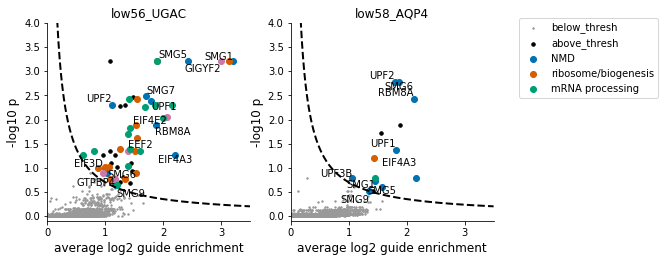

In [14]:
#plot
%matplotlib inline
import matplotlib.pyplot as plt
import scipy.stats as stats
from adjustText import adjust_text

plt.rcParams['pdf.fonttype'] = 42 #leaves most text as actual text in PDFs, not outlines

hitThreshold = 0.7

dataframe = combined_data[combined_data['id']!='Control_']

plots=[]
num_plots_wide = 2
num_plots_high = 2

fig = plt.figure(figsize=(4*num_plots_wide, 4*num_plots_high))
#fig.subplots_adjust(wspace=0.4, hspace=0.4)
plot_index =1
xy_pairs = [('pos|lfc', '-log10 pos|fdr')]
samples = ['low56_UGAC', 'low58_AQP4']
xmin=0
xmax=3.5

for sample in samples:
    sample_data = dataframe[dataframe['dataset'] == sample]
    for xy_pair in xy_pairs:
        x_label = xy_pair[0]
        y_label = xy_pair[1]
        sample_data['%s above threshold' % xy_pair[1]] = sample_data.apply(lambda row: above_threshold(hitThreshold, 1, row[xy_pair[0]], row[xy_pair[1]]), axis=1)

        gene_data_above_threshold = sample_data[sample_data['%s above threshold' % xy_pair[1]]]
        gene_data_below_threshold = sample_data[~sample_data['%s above threshold' % xy_pair[1]]]
        

        
        ribo_above = gene_data_above_threshold[(gene_data_above_threshold['id'].str.contains('RPS')) | (gene_data_above_threshold['id'].str.contains('RPL')) |  
                                                       (gene_data_above_threshold['id'].str.contains('GNB2L1')) | (gene_data_above_threshold['id'].str.contains('PES')) |
                                        (gene_data_above_threshold['id'].str.contains('NOP'))|
                                        (gene_data_above_threshold['id'].str.contains('NIP'))|
                                        (gene_data_above_threshold['id'].str.contains('POLR1'))|
                                         (gene_data_above_threshold['id'].str.contains('POLR3'))]
        tln_above = gene_data_above_threshold[(gene_data_above_threshold['id'].str.contains('EEF')) |
                                                (gene_data_above_threshold['id'].str.contains('EIF3')) |
                                               (gene_data_above_threshold['id'].str.contains('GIGY')) |
                                                (gene_data_above_threshold['id'].str.contains('4E2')) |
                                                (gene_data_above_threshold['id'].str.contains('ETF'))|
                                                (gene_data_above_threshold['id'].str.contains('GSPT'))|
                                             (gene_data_above_threshold['id'].str.contains('GTPBP'))|
                                             (gene_data_above_threshold['id'].str.contains('PELO'))]
    
        nmd_above = gene_data_above_threshold[(gene_data_above_threshold['id'].str.contains('UPF')) 
                                                | (gene_data_above_threshold['id'].str.contains('SMG'))
                                                | (gene_data_above_threshold['id'].str.contains('4A3'))
                                                 | (gene_data_above_threshold['id'].str.contains('RBM8A'))]

        splicing_above = gene_data_above_threshold[(gene_data_above_threshold['id'].str.contains('U2SU'))
                                    | (gene_data_above_threshold['id'].str.contains('ZNF830'))
                                   | (gene_data_above_threshold['id'].str.contains('SLU'))
                                   | (gene_data_above_threshold['id'].str.contains('NUP'))
                                     | (gene_data_above_threshold['id'].str.contains('XAB'))
                                  | (gene_data_above_threshold['id'].str.contains('ISY'))
                                  | (gene_data_above_threshold['id'].str.contains('DGCR14'))
                                  | (gene_data_above_threshold['id'].str.contains('SRR'))
                                  | (gene_data_above_threshold['id'].str.contains('DDX'))
                                  | (gene_data_above_threshold['id'].str.contains('AQR'))
                                     | (gene_data_above_threshold['id'].str.contains('RBM22'))
                                    | (gene_data_above_threshold['id'].str.contains('RBM25'))
                                                  | (gene_data_above_threshold['id'].str.contains('SRSF'))
                                                  |(gene_data_above_threshold['id'].str.contains('POLR2'))]
                                     
        '''
        gene_data_above_threshold = gene_data_above_threshold[(~gene_data_above_threshold['id'].isin(set(tln_above['id'])))
                                                              & (~gene_data_above_threshold['id'].isin(set(nmd_above['id'])))
                                                              & (~gene_data_above_threshold['id'].isin(set(rbp_above['id'])))
                                                             ]
        '''
        plot = fig.add_subplot(num_plots_high, num_plots_wide, plot_index)

        plot.scatter(gene_data_below_threshold[x_label], gene_data_below_threshold[y_label], s=2, color=gray, label='below_thresh')
        plot.scatter(gene_data_above_threshold[x_label], gene_data_above_threshold[y_label], s=12, color=black, label='above_thresh')
        
        groups = [nmd_above, ribo_above, tln_above, splicing_above]
        labels = ['NMD', 'ribosome/biogenesis', 'translation', 'mRNA processing']
        group_colors = [blue, vermillion, reddishPurple, bluishGreen, orange]
        texts = []
        for index in range(len(groups)):
            group = groups[index]
            group_label = labels[index]
            group_color = group_colors[index]
            if len(group) > 0:
                #print group_label, group_color, len(group)
                plot.scatter(group[x_label], group[y_label], s=36, color=group_color, label=group_label)
            if group_label in ('NMD', 'translation'):
                for x, y, s in zip(group[x_label], group[y_label], group['id']):
                    texts.append(plot.text(x, y, s))
                
                #adjust_text(texts)
                #adjust_text(texts)
                #adjust_text(texts)
                #adjust_text(texts)
                #adjust_text(texts)
        adjust_text(texts, only_move={'points':'y', 'text':'y'})
        
        plot.plot(np.linspace(xmin,xmax,1000),np.abs(hitThreshold/np.linspace(xmin/1,xmax/1,1000)),'k--', lw=2)
            
        plot.set_xlabel('average log2 guide enrichment', fontsize = 12)
        plot.set_ylabel('-log10 p', fontsize = 12)
        plot.set_xlim(xmin,xmax)
        plot.set_ylim(-.1,4)
        plot.spines['right'].set_visible(False)
        plot.spines['top'].set_visible(False)
        plot_index+=1
        plot.set_title(sample)

        plots.append(plot)
plt.legend(bbox_to_anchor=(1.1, 1.05))
#plt.tight_layout()
plt.savefig('mageck_volcano_plots.pdf', transparent='True', bbox_inches='tight')
#plt.savefig('20190625_mageck_volcano_plots_unlabelled.png', transparent='True', dpi=800)